In [25]:
import matplotlib.pyplot as plt
import pandas as p
import seaborn as sns
import numpy as np
%matplotlib inline

from scipy.stats import linregress
from scipy.spatial import distance
from matplotlib import colors
from matplotlib import gridspec
from matplotlib.gridspec import GridSpec
import scipy
import sys
import os
from matplotlib.backends.backend_pdf import PdfPages
# from sklearn.decomposition import PCA
from ast import literal_eval
from Bio import SeqIO
from itertools import combinations

%load_ext autoreload
%autoreload 2 

home_dir = '~/Documents/Stanford/Research/EvolvingFront/'
home_dir = os.path.expanduser(home_dir)

tools_path = f'{home_dir}/code/processing/tools/tools.py'
sys.path.append(os.path.dirname(os.path.expanduser(tools_path)))
import tools as tools

atish_assay_path = '../code/fitness_assay_grantedits.py'
sys.path.append(os.path.dirname(os.path.expanduser(atish_assay_path)))
import fitness_assay_grantedits as atish

tools_path = '../code/tools.py'
sys.path.append(os.path.dirname(os.path.expanduser(tools_path)))
import tools as tools

sns.set_color_codes()
sns.set_style('white')
sns.set_style('ticks')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [26]:
handpicked_neutrals = ['CGCTAAAGACATAATGTGGTTTGTTG_TTTTTAAAATGAAACAAGCTTGTATG',
'CGCTAAAGACATAATGTGGTTTGTTG_ATCTTAAGATAAAAGGCATTTTATTC',
'CGCTAAAGACATAATGTGGTTTGTTG_ACAGCAACCGTGAATGTACTTCGCAC',
'CGCTAAAGACATAATGTGGTTTGTTG_AGTATAAGCGCTAAATAATTTTCTCC',
'CGCTAAAGACATAATGTGGTTTGTTG_AGCATAATCTTTAACACGCTTGTCAG',
'CGCTAAAGACATAATGTGGTTTGTTG_CCGTTAAAAAGAAATGATTTTTATAG',
'CGCTAAAGACATAATGTGGTTTGTTG_CCAGTAATTGGAAAACTCCTTGGGAA',
'CGCTAAAGACATAATGTGGTTTGTTG_ATAGCAACCCAGAAGATCCTTATCTG',
'CGCTAAAGACATAATGTGGTTTGTTG_CTGAAAAGAGATAAATATTTTACATC',
'CGCTAAAGACATAATGTGGTTTGTTG_GGAACAAATCAAAATTAATTAACAAA',
'CGCTAAAGACATAATGTGGTTTGTTG_TAGGAAATTCCAAAGAAATTTGGTAA',
'CGCTAAAGACATAATGTGGTTTGTTG_GTTAAAAATGAGAAGTCTATTCGCTT',
'CGCTAAAGACATAATGTGGTTTGTTG_TGGAAAAACGCCAAGGGCGTTTTATC',
'CGCTAAAGACATAATGTGGTTTGTTG_CTATTAACCGACAATCATCTTAATTT',
'CGCTAAAGACATAATGTGGTTTGTTG_CATCTAATTGATAACTTCTTTCCCGC',
'CGCTAAAGACATAATGTGGTTTGTTG_ATGGAAACAAAAAATAGTATTCGCAC',
'CGCTAAAGACATAATGTGGTTTGTTG_TAAGAAAATCAGAACCGCTTTCAGGG',
'CGCTAAAGACATAATGTGGTTTGTTG_GCTTTAATGAAAAATTATTTTGGCTG',
'CGCTAAAGACATAATGTGGTTTGTTG_CTCCTAACCAGTAATAACTTTCTCAA',
'CGCTAAAGACATAATGTGGTTTGTTG_GTCCAAAACAACAAATGCACTTGCAA',
'CGCTAAAGACATAATGTGGTTTGTTG_TTTTTAATTTGCAAGGACCTTAGTCT',
'CGCTAAAGACATAATGTGGTTTGTTG_TGCATAACCTGCAAACAGATTGCCGT',
'CGCTAAAGACATAATGTGGTTTGTTG_GCATCAATGATCAACGCGGTTACCTG',
'CGCTAAAGACATAATGTGGTTTGTTG_AGGCTAATACCCAATTCGATTGTCAT',
'CGCTAAAGACATAATGTGGTTTGTTG_TTTTCAAATAGTAATTGATTTCCAGT',
'CGCTAAAGACATAATGTGGTTTGTTG_AAGCTAATTGAGAATTATTTTGCATT',
'CGCTAAAGACATAATGTGGTTTGTTG_TTGCGAATACGTAATTTTGTTGCGGG',
'CGCTAAAGACATAATGTGGTTTGTTG_CAGTAAACGATCAAATACTTTCAATA',
'CGCTAAAGACATAATGTGGTTTGTTG_TAACAAATGTCTAATGGAATTTTGCA',
'CGCTAAAGACATAATGTGGTTTGTTG_GTTGTAATCTCGAAGAGATTTCTAGC',
'CGCTAAAGACATAATGTGGTTTGTTG_AGAATAAATGAAAAATCATTTAATAT',
'CGCTAAAGACATAATGTGGTTTGTTG_TCAAAAAATTAAAACCAATTTATCTC',
'CGCTAAAGACATAATGTGGTTTGTTG_ATACTAAAAAGTAAAGTGGTTATTCT',
'CGCTAAAGACATAATGTGGTTTGTTG_TACGAAAGCTCTAATGCATTTACAAG',
'CGCTAAAGACATAATGTGGTTTGTTG_CTCGTAAGCTGTAAGCCTTTTGATTG',
'CGCTAAAGACATAATGTGGTTTGTTG_CACGTAACGCAGAAGTGCTTTGAAAG',
'CGCTAAAGACATAATGTGGTTTGTTG_CTACGAACTACGAAATGCCTTGTTTC',
'CGCTAAAGACATAATGTGGTTTGTTG_GACTAAAACTGTAACATTTTTAATGG',
'CGCTAAAGACATAATGTGGTTTGTTG_GAGGAAAATTATAACGAATTTTGTCG',
'CGCTAAAGACATAATGTGGTTTGTTG_CGATTAACTAATAATTCTTTTTAAAG',
'CGCTAAAGACATAATGTGGTTTGTTG_TTTCCAAATGTAAAGCGTATTCATAC',
'CGCTAAAGACATAATGTGGTTTGTTG_GGTAGAATATGGAATGTTTTTACGAA',
'CGCTAAAGACATAATGTGGTTTGTTG_GTGTGAATCAATAAGCATATTGTTTA',
'CGCTAAAGACATAATGTGGTTTGTTG_TCCCCAACCATTAATTATGTTTACAC',
'CGCTAAAGACATAATGTGGTTTGTTG_ACCCCAAATACCAAAGGAGTTGCGTG',
'CGCTAAAGACATAATGTGGTTTGTTG_TCGACAAATTGCAAGAAGGTTTCATC',
'CGCTAAAGACATAATGTGGTTTGTTG_TCGATAATGACCAATACCATTTTGTC',
'CGCTAAAGACATAATGTGGTTTGTTG_CGGAAAACATTGAACTTTATTAATGG',
'CGCTAAAGACATAATGTGGTTTGTTG_AGGGAAAACAGGAAACCCGTTTCCCT',
'CGCTAAAGACATAATGTGGTTTGTTG_TTTTCAACCGGTAATTAAATTCTCGT',
'CGCTAAAGACATAATGTGGTTTGTTG_ATTCAAATCGAAAATGATGTTCTTCA',
'CGCTAAAGACATAATGTGGTTTGTTG_AATAGAACCCCAAATATTTTTTCTCG',
'CGCTAAAGACATAATGTGGTTTGTTG_TGCTTAAGCGCGAAATGCTTTACACC',
'CGCTAAAGACATAATGTGGTTTGTTG_CGGCCAATTTGGAAGTCGCTTATATA',
'CGCTAAAGACATAATGTGGTTTGTTG_TTCATAAACTCTAACAACCTTTTTAG',
'CGCTAAAGACATAATGTGGTTTGTTG_ACGAGAATAGCAAACGCAGTTGAGCG',
'CGCTAAAGACATAATGTGGTTTGTTG_GCATCAAGAATAAAGCGGGTTCCGCT',
'CGCTAAAGACATAATGTGGTTTGTTG_CAAATAATCAAGAACGGCCTTATGTT',
'CGCTAAAGACATAATGTGGTTTGTTG_AAAGAAAAGCTTAAAGATATTGATGA',
'CGCTAAAGACATAATGTGGTTTGTTG_CAATCAAGGGTCAATTAACTTTTCAA']

In [27]:
rebarcoding_source_mutants = {
'IRA1_MIS':'CGCTAAAGACATAATGTGGTTTGTTG_CTTCCAACAAAAAATCATTTTTATAC', # BCID 43361 from venkataram 2016
'IRA1_NON':'CGCTAAAGACATAATGTGGTTTGTTG_AGAGTAATCTGCAAGATTCTTTTTCT', # BCID 21967 from venkataram 2016
'CYR1':    'CGCTAAAGACATAATGTGGTTTGTTG_CTCGAAACAGGAAAAGCACTTATCGA', # BCID 43692 from venkataram 2016
'TOR1':    'CGCTAAAGACATAATGTGGTTTGTTG_TAGACAAAATGCAATTGTATTGTCAG' , # BCID 21543 from venkataram 2016
'GPB2':    'CGCTAAAGACATAATGTGGTTTGTTG_TCATGAACGGATAAGCTGGTTGGTTG' , # BCID 7774 from venkataram 2016
}



new_lowcomplexity_dict = {
#     'EVO1D_IRAs':[
# #         'CATAAAAAGACTAATCTTATTAATGC', # 74D-2 (Ira1 mis)
#                   'AATGCAATAATGAAATGATTTGAGGA',
# #                  'TGTACAAATCTTAAGAAGATTACAAG',  #YP 12 (IRA1 non)
#                   'GAAATAAACCACAACGACATTCTAAT',
# #                   'CCTACAAATACTAAGGCTATTCCTAT', #YP 10 (IRA1 non)
#                  ]
    
    'EVO1D_IRA1_MIS':['CATAAAAAGACTAATCTTATTAATGC'],
    
    'EVO1D_IRA1_NON':['CCTACAAATACTAAGGCTATTCCTAT','TGTACAAATCTTAAGAAGATTACAAG',
                     'AATGCAATAATGAAATGATTTGAGGA','GAAATAAACCACAACGACATTCTAAT'],
    
#     'EVO1D_TCG':['CCGCCAATCCCGAACCCCGTTTCGCC','GACAGAAAAGCCAAATGGATTTACCG',
#  'ATCAGAAGTTCGAATCAAATTACGAA','CCAACAAAAGGAAACGTATTTATTGA',
#  'TTAAAAATACAAAAAAAGATTTAAGG','AGAACAAAAACTAAACTCATTCATGG',
#  'ACTTAAAAAGCAAACATGATTATTCA','GTATTAAAATTAAAAATAATTGCACA',
#  'CTAGAAATCTCAAAAACTTTTGGCTG','CAGAAAAGCCATAACGCTATTTGAAA'],
    
    'EVO2D_IRA1_NON':['CCAACAAAACACAAATCTGTTGTGTA'],

    'EVO2D_IRA1_MIS':['TGATCAATCTACAAAAATATTTAATG','CATTGAATCACAAAATAGGTTAGATG'],

    'EVO3D_IRA1_NON':['ATCACAATAACTAAACTGATTCTTCA'],

    'EVO3D_IRA1_MIS':['TATCGAAACCCAAAGAGATTTAATCG'],

    'CYR1':['AGAACAAAAACTAAACTCATTCATGG','GACAGAAAAGCCAAATGGATTTACCG',
           'CTAGAAATCTCAAAAACTTTTGGCTG','ACTTAAAAAGCAAACATGATTATTCA',
            'CAGAAAAGCCATAACGCTATTTGAAA'],
    
    'GPB2':['CCGCCAATCCCGAACCCCGTTTCGCC','GTATTAAAATTAAAAATAATTGCACA',
            'CCAACAAAAGGAAACGTATTTATTGA'],
    
    'TOR1':['ATCAGAAGTTCGAATCAAATTACGAA','TTAAAAATACAAAAAAAGATTTAAGG'],
    

}

new_lowcomplexity_bc_to_entry_dict = {}

for key,items in new_lowcomplexity_dict.items():
    for bc in items:
        new_lowcomplexity_bc_to_entry_dict[bc] = key

new_lowcomplexity_barcodes = [item for key,items in new_lowcomplexity_dict.items() for item in items ]

new_lowcomplexity_by_anc = {}
new_lowcomplexity_by_anc['IRA1_MIS'] = []
for key in ['EVO1D_IRA1_MIS','EVO2D_IRA1_MIS','EVO3D_IRA1_MIS']:
    for bc in new_lowcomplexity_dict[key]:
        new_lowcomplexity_by_anc['IRA1_MIS'].append(bc)
    
new_lowcomplexity_by_anc['IRA1_NON'] = []
for key in ['EVO1D_IRA1_NON','EVO2D_IRA1_NON','EVO3D_IRA1_NON']:
    print(key,new_lowcomplexity_dict[key])
    for bc in new_lowcomplexity_dict[key]:
        new_lowcomplexity_by_anc['IRA1_NON'].append(bc)
        
        
new_lowcomplexity_by_anc['CYR1'] = new_lowcomplexity_dict['CYR1']
new_lowcomplexity_by_anc['GPB2'] = new_lowcomplexity_dict['GPB2']
new_lowcomplexity_by_anc['TOR1'] = new_lowcomplexity_dict['TOR1']

EVO1D_IRA1_NON ['CCTACAAATACTAAGGCTATTCCTAT', 'TGTACAAATCTTAAGAAGATTACAAG', 'AATGCAATAATGAAATGATTTGAGGA', 'GAAATAAACCACAACGACATTCTAAT']
EVO2D_IRA1_NON ['CCAACAAAACACAAATCTGTTGTGTA']
EVO3D_IRA1_NON ['ATCACAATAACTAAACTGATTCTTCA']


In [28]:
conditions = ['Fit1D-2%','Fit1D-5%',
              'Fit2D-2%','Fit2D-5%',
              'Fit3D-2%','Fit3D-5%',
              'Fit5D-2%','Fit5D-5%']

# replicates = [1,2,3]
replicates = {'Fit1D-2%':[1,2],
              'Fit1D-5%':[1,2],
              'Fit2D-2%':[1,2],
              'Fit2D-5%':[1,2],
              'Fit3D-2%':[1,2,3],
              'Fit3D-5%':[1,2,3],
              'Fit5D-2%':[1,2,3],
              'Fit5D-5%':[1,2,3]}

timepoints = {'Fit1D-2%':7,
              'Fit1D-5%':7,
              'Fit2D-2%':7,
              'Fit2D-5%':7,
              'Fit3D-2%':3,
              'Fit3D-5%':3,
              'Fit5D-2%':3,
              'Fit5D-5%':3}

In [29]:
ploidy_calls = p.read_csv(f'{home_dir}/BenomylTest/EvolvingFront_rearray_map_with_ploidy.csv')

In [30]:
merged_fitness = p.read_csv(f'{home_dir}/data/EvolvingFront_2%5%FitnessMeasurementData.csv')
time_fitness = p.read_csv(f'{home_dir}/data/EvolvingFront_2%5%FitnessMeasurementData_fitnessByTime.csv')

In [31]:
full_cloneID_list = []
full_ploidy_list = []
evo_cond_list = []
anc_list = []

for barcode,cloneID,source,ploidy,evo_cond,anc in zip(merged_fitness['barcode'].values,
                                         merged_fitness['cloneID'].values,
                                         merged_fitness['source_publication'].values,
                                         merged_fitness['ploidy'].values,
                                         merged_fitness['evolution_condition'].values,
                                         merged_fitness['ancestor'].values):
    if source == 'This_study':
        
        
        this_bc = ploidy_calls[ploidy_calls['barcode']==barcode]
        
        if len(this_bc) == 0:
            this_id = np.nan
            full_cloneID_list.append(np.nan)
            full_ploidy_list.append('?')
        elif len(this_bc) > 1:
            print('hmm... more that one found')
            full_cloneID_list.append(this_bc['destination_well'].values[0])
            full_ploidy_list.append(this_bc['ploidy'].values[0])
            this_id = this_bc['destination_well'].values[0]
        else:
            full_cloneID_list.append(this_bc['destination_well'].values[0])
            full_ploidy_list.append(this_bc['ploidy'].values[0])
            this_id = this_bc['destination_well'].values[0]
#         print('this_condition')
        
        bc_low_complexity = barcode.split('_')[0]
        
        entry = new_lowcomplexity_bc_to_entry_dict[bc_low_complexity]
        
        if 'IRA1_NON' in entry:
            anc_list.append('IRA1_NON')
        elif 'IRA1_MIS' in entry:
            anc_list.append('IRA1_MIS')
        elif entry in ['TOR1','CYR1','GPB2']:
            anc_list.append(entry)
            entry = this_id
            
        
        if not p.isnull(entry):
            if 'EVO1D' in entry:
                evo_cond_list.append('Evo1D')
            elif 'EVO2D' in entry:
                evo_cond_list.append('Evo2D')
            elif 'EVO3D' in entry:
                evo_cond_list.append('Evo3D')
            else:
                evo_cond_list.append('unknown')
        else:
            evo_cond_list.append('unknown')
            
        
        
        

    
    else:

        full_cloneID_list.append(cloneID)
        full_ploidy_list.append(ploidy)
        evo_cond_list.append(evo_cond)
        anc_list.append(anc)
        
merged_fitness['cloneID_new'] = full_cloneID_list
merged_fitness['ploidy_new'] = full_ploidy_list
merged_fitness['evolution_condition'] = evo_cond_list
merged_fitness['ancestor'] = anc_list

hmm... more that one found
hmm... more that one found
hmm... more that one found
hmm... more that one found
hmm... more that one found
hmm... more that one found
hmm... more that one found


In [32]:
new_conditions = {'Fit1D_both2%5%':['Fit1D-2%','Fit1D-5%'],
                 'Fit2D_both2%5%':['Fit2D-2%','Fit2D-5%'],
                 'Fit3D_both2%5%':['Fit3D-2%','Fit3D-5%'],
                 'Fit5D_both2%5%':['Fit5D-2%','Fit5D-5%']}


for new_condition,old_conditions in new_conditions.items():
    
    new_fitness, new_error = tools.inverse_variance_mean(merged_fitness[[f'{condition}_fitness' for condition in old_conditions]].values,
                                                   merged_fitness[[f'{condition}_error' for condition in old_conditions]].values)
    
    merged_fitness[f'{new_condition}_fitness'] = new_fitness
    merged_fitness[f'{new_condition}_error'] = new_error
    
    new_fitness_li, new_error_li = tools.inverse_variance_mean(merged_fitness[[f'{condition}_fitness_Li2019Neutrals' for condition in old_conditions]].values,
                                                   merged_fitness[[f'{condition}_error_Li2019Neutrals' for condition in old_conditions]].values)
  
    merged_fitness[f'{new_condition}_fitness_Li2019Neutrals'] = new_fitness_li
        
    merged_fitness[f'{new_condition}_error_Li2019Neutrals'] = new_error_li


In [33]:
merged_fitness[[f'{condition}_fitness' for condition in old_conditions]]

,Fit5D-2%_fitness,Fit5D-5%_fitness
0,1.113582,1.422631
1,2.990873,2.899317
2,1.953053,2.219151
3,-0.124679,-0.407990
4,1.941282,2.440328
...,...,...
5021,-0.020293,0.932721
5022,0.822971,0.883740
5023,0.271826,0.520620
5024,0.517895,0.694773


In [34]:
merged_fitness

,Fit1D-2%-R1_fitness,Fit1D-2%-R1_error,Fit1D-2%-R2_fitness,Fit1D-2%-R2_error,Fit1D-5%-R1_fitness,Fit1D-5%-R1_error,Fit1D-5%-R2_fitness,Fit1D-5%-R2_error,Fit2D-2%-R1_fitness,Fit2D-2%-R1_error,...,Fit2D_both2%5%_fitness_Li2019Neutrals,Fit2D_both2%5%_error_Li2019Neutrals,Fit3D_both2%5%_fitness,Fit3D_both2%5%_error,Fit3D_both2%5%_fitness_Li2019Neutrals,Fit3D_both2%5%_error_Li2019Neutrals,Fit5D_both2%5%_fitness,Fit5D_both2%5%_error,Fit5D_both2%5%_fitness_Li2019Neutrals,Fit5D_both2%5%_error_Li2019Neutrals
0,0.770538,0.056064,0.798667,0.056490,0.793227,0.037792,0.777312,0.034586,1.152181,0.032200,...,1.883898,0.017769,1.552972,0.052341,2.583981,0.052341,1.224707,0.062951,2.978928,0.062951
1,0.938763,0.035535,1.009834,0.036124,0.936852,0.024449,0.940881,0.024295,1.721427,0.024800,...,2.370876,0.014468,3.124871,0.029720,4.151767,0.029720,2.945852,0.034956,4.686098,0.034956
2,0.850726,0.053260,0.837848,0.056183,0.847252,0.039778,0.851379,0.033796,1.230381,0.030045,...,1.974673,0.017027,2.209557,0.044930,3.238917,0.044930,2.050791,0.050844,3.807420,0.050844
3,1.074590,0.049368,1.048208,0.050017,0.913976,0.039413,0.963205,0.035169,1.364335,0.032921,...,2.082406,0.018237,1.416678,0.075140,2.450472,0.075140,-0.229300,0.258695,1.506701,0.258695
4,0.931656,0.050006,0.962649,0.052219,0.851260,0.038401,0.939050,0.034383,1.111230,0.035139,...,1.820916,0.019590,1.688100,0.061451,2.717293,0.061451,2.083678,0.064446,3.852562,0.064446
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5021,0.388302,0.833230,0.405459,0.622680,0.182802,0.424601,0.998668,0.298171,0.726315,0.660909,...,1.326408,0.298048,0.111080,0.963457,1.151594,0.963457,0.575905,0.959078,2.310693,0.959078
5022,0.779675,0.079662,0.802178,0.078588,0.714047,0.057034,0.810990,0.048184,0.713101,0.114501,...,1.414582,0.049285,0.668848,0.144437,1.707793,0.144437,0.839425,0.159220,2.601292,0.159220
5023,0.482098,0.188088,0.630145,0.145766,0.495766,0.132897,0.457116,0.097001,0.576438,0.270611,...,1.247043,0.103618,0.559253,0.254961,1.598812,0.254961,0.366615,0.280315,2.120474,0.280315
5024,0.822036,0.084740,0.806927,0.090888,0.685954,0.066067,0.751837,0.054305,0.704487,0.129870,...,1.396007,0.059379,0.558246,0.189933,1.604822,0.189933,0.573966,0.219226,2.334107,0.219226


In [35]:
for anc in np.unique(merged_fitness['ancestor'].values):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
    print(anc)
    evos,counts = np.unique(this_anc['evolution_condition'].values,return_counts=True)
    print([(e,c)for (e,c) in zip(evos,counts)])

CYR1
[('Evo1D', 211), ('Evo2D', 535), ('Evo3D', 35), ('unknown', 11)]
GPB2
[('Evo1D', 169), ('Evo2D', 1219), ('Evo3D', 34), ('unknown', 294)]
IRA1_MIS
[('Evo1D', 191), ('Evo2D', 145), ('Evo3D', 32)]
IRA1_NON
[('Evo1D', 12), ('Evo2D', 95), ('Evo3D', 135)]
TOR1
[('Evo1D', 203), ('Evo2D', 726), ('Evo3D', 2), ('unknown', 10)]
WT
[('Evo1D', 112), ('Evo1_5D', 239), ('Evo2D', 506), ('Evo5D', 110)]


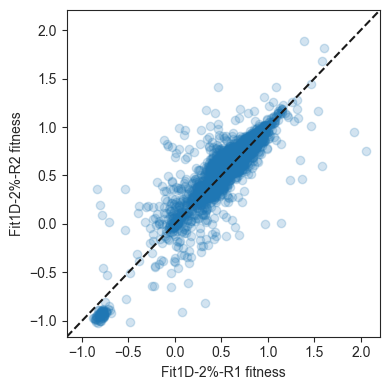

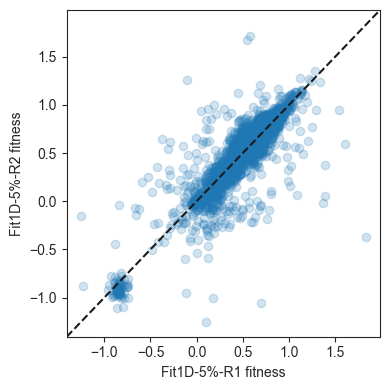

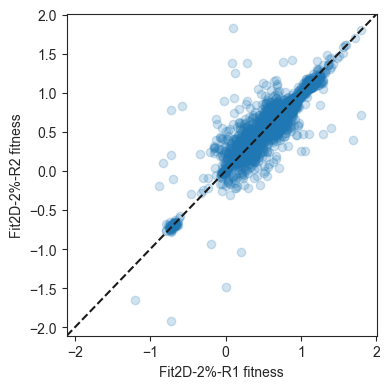

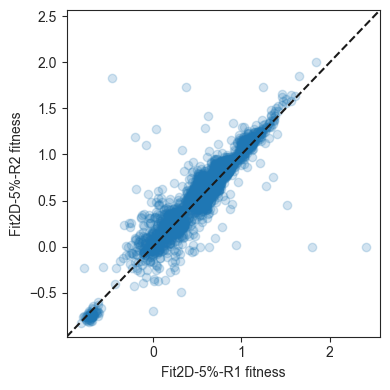

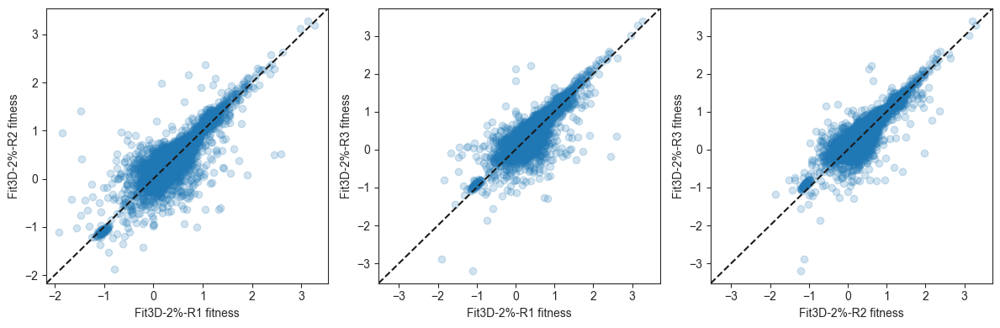

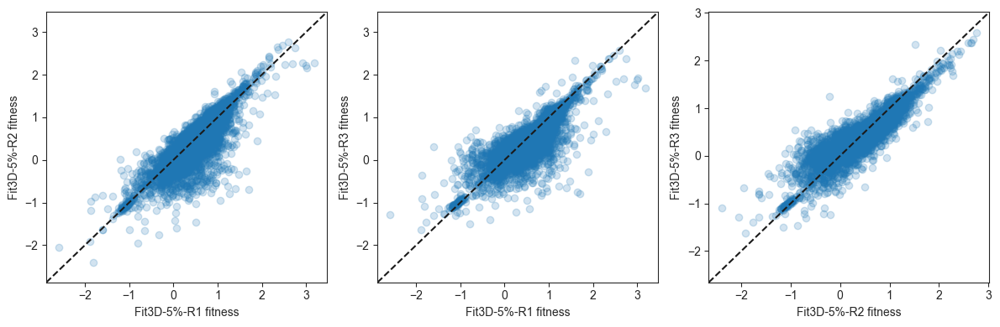

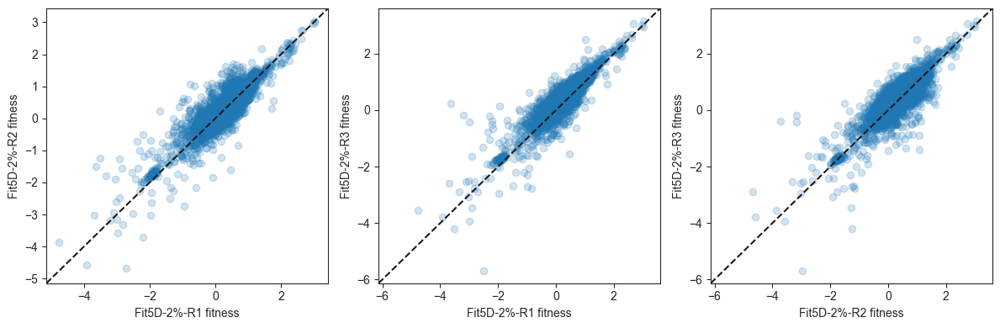

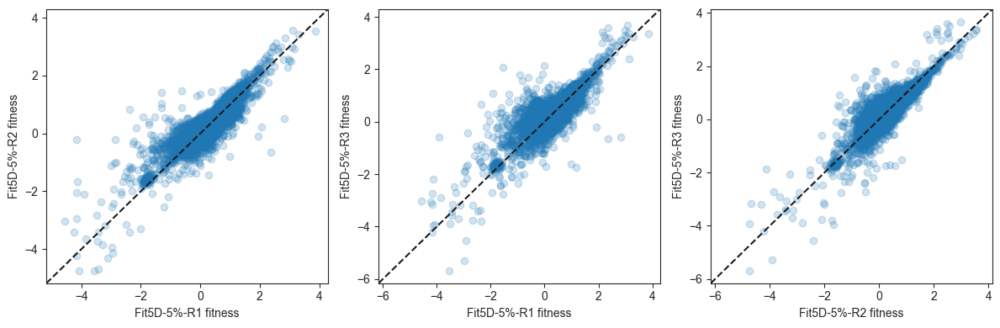

In [36]:
for condition in conditions:
    plt.figure(figsize=(4*scipy.special.comb(len(replicates[condition]),2),4))
    for i,(rep1,rep2) in enumerate(combinations(replicates[condition],2)):
        plt.subplot(1,int(scipy.special.comb(len(replicates[condition]),2)),i+1)
        plt.scatter(merged_fitness[f'{condition}-R{rep1}_fitness'].values,merged_fitness[f'{condition}-R{rep2}_fitness'].values,alpha=0.2)
        plt.xlabel(f'{condition}-R{rep1} fitness')
        plt.ylabel(f'{condition}-R{rep2} fitness')
        
        xmin,xmax = plt.xlim()
        ymin,ymax = plt.ylim()
        new_min = np.min([xmin,ymin])
        new_max = np.max([xmax,ymax])

        plt.xlim(new_min,new_max)
        plt.ylim(new_min,new_max)
        plt.plot([new_min,new_max],[new_min,new_max],'k--')
        plt.tight_layout()
        
#     plt.savefig(f'plots/{condition}_replicate_correlation.pdf',bbox_inches='tight')

-0.6655258396154313
0.7082750359095848
0.7083727575875052


Text(0, 0.5, 'Fitness with Li Neutrals')

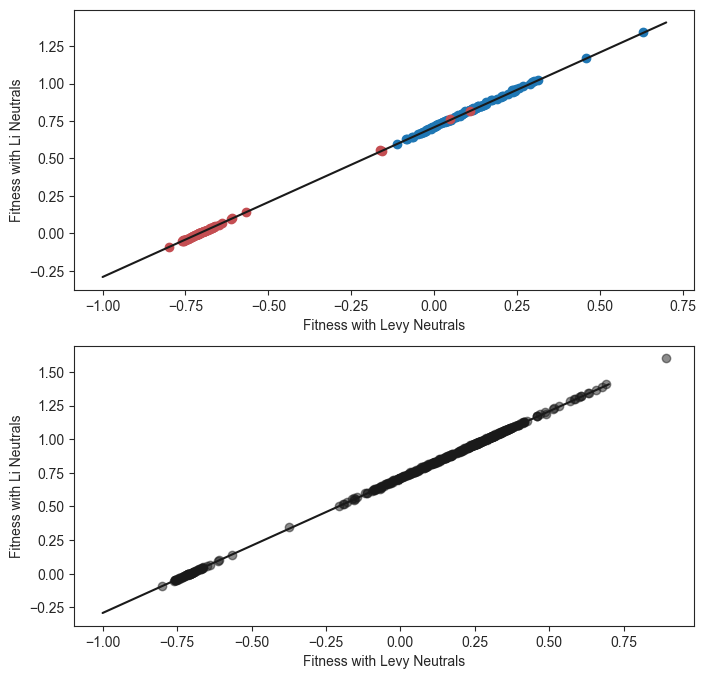

In [37]:
li_mutants = merged_fitness[merged_fitness['source_publication']=='Li2019']
li_diploids = li_mutants[li_mutants['class']=='pure_diploids']
li_neutrals = li_mutants[li_mutants['class']=='neutral_haploids']

onlyVen = merged_fitness[merged_fitness['source_publication']=='Venkataram2015']
onlyVen_diploids = onlyVen[onlyVen['class']=='pure_diploids']
onlyVen_neutrals = onlyVen[onlyVen['class']=='neutral_haploids']

plt.figure(figsize=(8,8))

plt.subplot(211)

plt.scatter(li_diploids['Fit2D_both2%5%_fitness'].values,li_diploids['Fit2D_both2%5%_fitness_Li2019Neutrals'].values,label='Diploids')
plt.scatter(li_neutrals['Fit2D_both2%5%_fitness'].values,li_neutrals['Fit2D_both2%5%_fitness_Li2019Neutrals'].values,color='r',label='Neutrals')



const_diff =  np.mean(li_neutrals['Fit2D_both2%5%_fitness_Li2019Neutrals'].values) - np.mean(li_neutrals['Fit2D_both2%5%_fitness'].values)
print(np.mean(li_neutrals['Fit2D_both2%5%_fitness'].values))
print(np.median(li_neutrals['Fit2D_both2%5%_fitness_Li2019Neutrals'].values) - np.median(li_neutrals['Fit2D_both2%5%_fitness'].values))
print(const_diff)                     
plt.plot([-1,0.7],[-1+const_diff,0.7+const_diff],'k',label = 'if constant difference (according to haploids)')                    


plt.xlabel('Fitness with Levy Neutrals')
plt.ylabel('Fitness with Li Neutrals')

plt.subplot(212)


plt.scatter(li_mutants['Fit2D_both2%5%_fitness'].values,li_mutants['Fit2D_both2%5%_fitness_Li2019Neutrals'].values,color='k',alpha=0.5)


const_diff =  np.mean(li_neutrals['Fit2D_both2%5%_fitness_Li2019Neutrals'].values) - np.mean(li_neutrals['Fit2D_both2%5%_fitness'].values)
                     
plt.plot([-1,0.7],[-1+const_diff,0.7+const_diff],'k',label = 'if constant difference (according to haploids)')                    


plt.xlabel('Fitness with Levy Neutrals')
plt.ylabel('Fitness with Li Neutrals')
# merged_fitness[merged_fitness['source_publication']=='Li2019']['class'].values

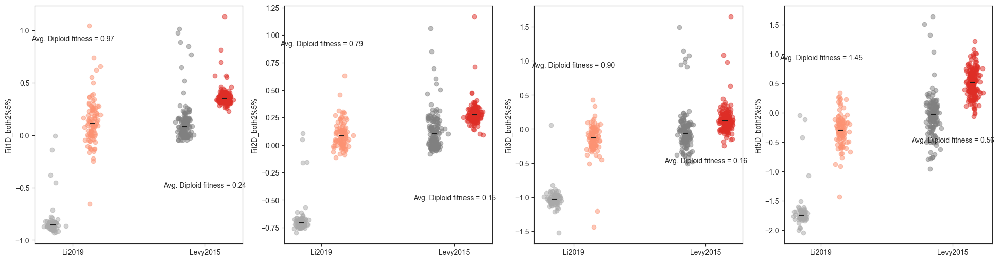

In [38]:
these_conditions = ['Fit1D_both2%5%','Fit2D_both2%5%','Fit3D_both2%5%','Fit5D_both2%5%']

plt.figure(figsize=(24,6))
for c,condition in enumerate(these_conditions):
    plt.subplot(1,4,c+1)

    plt.scatter([tools.jitter_point(0.2,0.05) for x in range(len(li_neutrals[f'{condition}_fitness']))],
               li_neutrals[f'{condition}_fitness'],alpha=0.5,color='darkgray')
    plt.scatter(0.2,np.nanmedian(li_neutrals[f'{condition}_fitness']),color='k',marker='_',s=50)

    plt.scatter([tools.jitter_point(0.8,0.05) for x in range(len(li_diploids[f'{condition}_fitness']))],
               li_diploids[f'{condition}_fitness'],alpha=0.5,color='#fc9272')
    plt.scatter(0.8,np.nanmedian(li_diploids[f'{condition}_fitness']),color='k',marker='_',s=50)


    plt.scatter([tools.jitter_point(2.2,0.05) for x in range(len(onlyVen_neutrals[f'{condition}_fitness']))],
               onlyVen_neutrals[f'{condition}_fitness'],alpha=0.5,color='gray')
    plt.scatter(2.2,np.nanmedian(onlyVen_neutrals[f'{condition}_fitness']),color='k',marker='_',s=50)

    plt.scatter([tools.jitter_point(2.8,0.05) for x in range(len(onlyVen_diploids[f'{condition}_fitness']))],
               onlyVen_diploids[f'{condition}_fitness'],alpha=0.5,color='#de2d26')
    plt.scatter(2.8,np.nanmedian(onlyVen_diploids[f'{condition}_fitness']),color='k',marker='_',s=50)

    # plt.scatter([tools.jitter_point(1,0.05) for x in range(len(onlyVen_diploids[f'{condition}_fitness']))],
    #            onlyVen_diploids[f'{condition}_fitness']-np.mean(onlyVen_neutrals[f'{condition}_fitness']),alpha=0.5)

    plt.xticks([0.5,2.5],['Li2019','Levy2015'])
    # plt.text(0.2)
    plt.ylabel(f'{condition}')

    li_diff = np.median(li_diploids[f'{condition}_fitness']) - np.median(li_neutrals[f'{condition}_fitness'])

    plt.annotate(text=f'Avg. Diploid fitness = {li_diff:.2f}',ha='center',xytext=(0.5,0.9),xy=(0.5,0.7),arrowprops=dict(arrowstyle="-[,widthB=3.0,lengthB=0.8,angleB=90"))



    ven_diff = np.mean(onlyVen_diploids[f'{condition}_fitness']) - np.mean(onlyVen_neutrals[f'{condition}_fitness'])
    plt.annotate(text=f'Avg. Diploid fitness = {ven_diff:.2f}',ha='center',xytext=(2.5,-0.5),xy=(2.5,-0.3),arrowprops=dict(arrowstyle="-[,widthB=3.0,lengthB=0.8,angleB=90"))

# plt.savefig('plots/diploid_additivity.pdf',bbox_inches='tight')

In [39]:
np.median(onlyVen_neutrals['Fit2D_both2%5%_fitness'])-np.mean(li_neutrals['Fit2D_both2%5%_fitness'])

np.mean(onlyVen_diploids['Fit2D_both2%5%_fitness'])-np.mean(li_diploids['Fit2D_both2%5%_fitness'])

0.18394251615495716

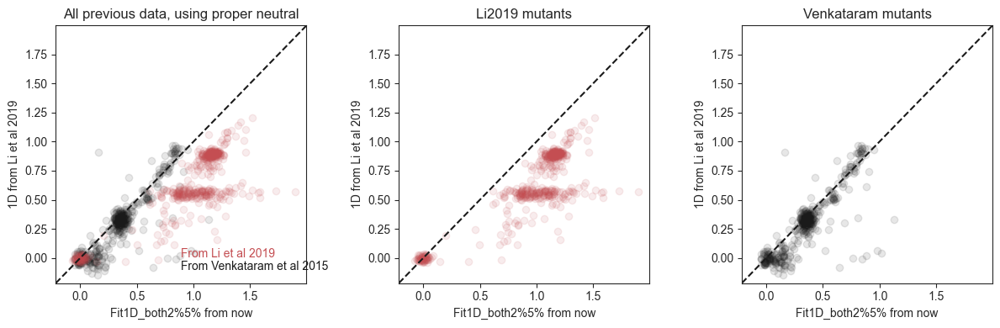

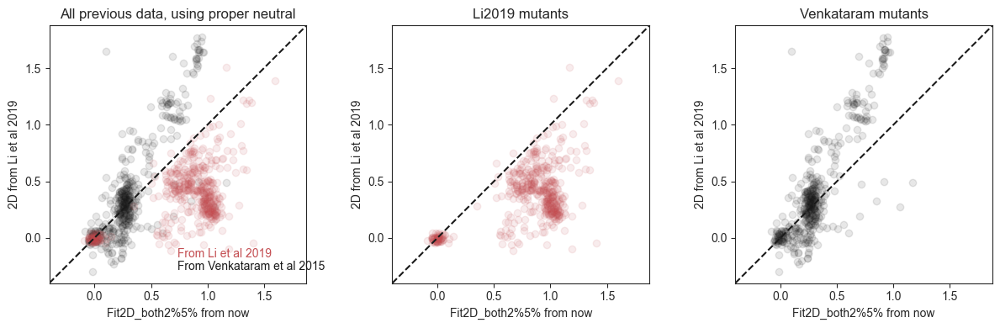

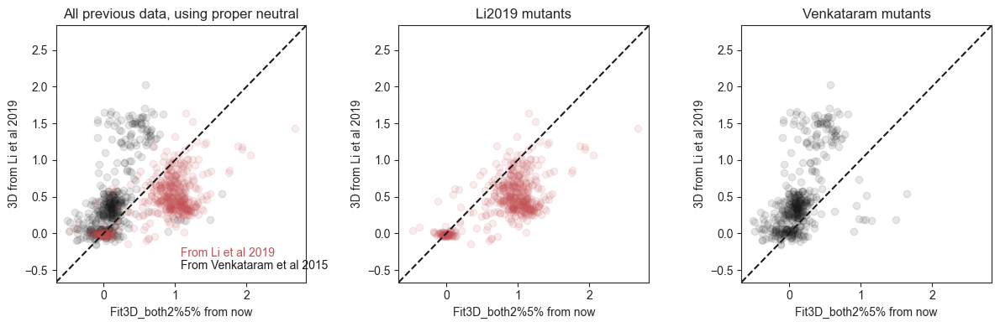

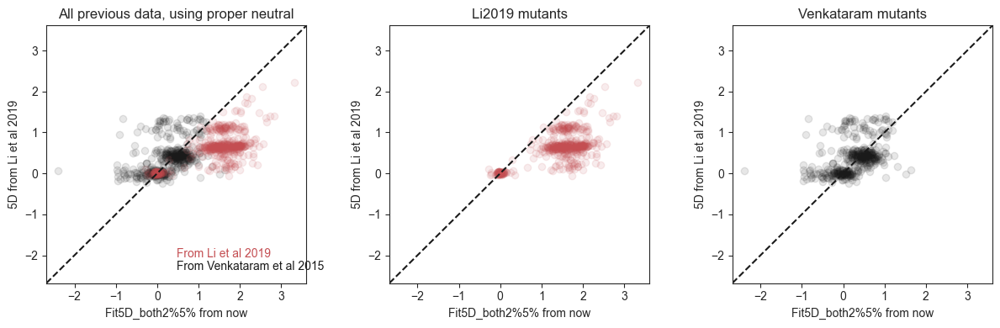

In [40]:
colors = ['b' if source=='This_study' else 'r' if source=='Li2019' else 'orange' if source == 'Aggeli2020' else 'k' for source in merged_fitness['source_publication']]

these_conditions = ['Fit1D-2%','Fit1D-5%','Fit2D-2%','Fit2D-5%','Fit3D_both2%5%','Fit5D_both2%5%']
these_conditions = ['Fit1D_both2%5%','Fit2D_both2%5%','Fit3D_both2%5%','Fit5D_both2%5%']
for condition in these_conditions:
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    
    onlyVen = merged_fitness[merged_fitness['source_publication']=='Venkataram2015']
    plt.scatter(onlyVen[f'{condition}_fitness'].values,onlyVen[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='k')
    
    onlyLi = merged_fitness[merged_fitness['source_publication']=='Li2019']
    plt.scatter(onlyLi[f'{condition}_fitness_Li2019Neutrals'].values,onlyLi[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='r')


    
    plt.title('All previous data, using proper neutral')
#     plt.scatter(merged_fitness[f'{condition}_fitness'].values,merged_fitness[f'{condition.replace("Fit","")}_Fitness_Li2019'].values,alpha=0.1,color=colors)
    plt.xlabel(f'{condition} from now')
    plt.ylabel(f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")} from Li et al 2019')
    
    xmin,xmax = plt.xlim()
    ymin,ymax = plt.ylim()
    new_min = np.min([xmin,ymin])
    new_max = np.max([xmax,ymax])
    
    plt.xlim(new_min,new_max)
    plt.ylim(new_min,new_max)
    plt.plot([new_min,new_max],[new_min,new_max],'k--')
    
    plt.text(s='From Li et al 2019',color='r',x=0.5,y=0.1,transform=plt.gca().transAxes)
    plt.text(s='From Venkataram et al 2015',color='k',x=0.5,y=0.05,transform=plt.gca().transAxes)
    
#     if condition == 'Fit1D':
#         plt.plot([new_min,new_max],[new_min+0.3,new_max+0.3],'r')
        
    plt.subplot(1,3,2)
    plt.title('Li2019 mutants')
    onlyLi = merged_fitness[merged_fitness['source_publication']=='Li2019']
    plt.scatter(onlyLi[f'{condition}_fitness_Li2019Neutrals'].values,onlyLi[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='r')
    plt.xlabel(f'{condition} from now')
    plt.ylabel(f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")} from Li et al 2019')
    

    
    plt.xlim(new_min,new_max)
    plt.ylim(new_min,new_max)
    plt.plot([new_min,new_max],[new_min,new_max],'k--')
    
    plt.subplot(1,3,3)
    plt.title('Venkataram mutants')
    onlyVen = merged_fitness[merged_fitness['source_publication']=='Venkataram2015']
    plt.scatter(onlyVen[f'{condition}_fitness'].values,onlyVen[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='k')
    plt.xlabel(f'{condition} from now')
    plt.ylabel(f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")} from Li et al 2019')
    
    plt.xlim(new_min,new_max)
    plt.ylim(new_min,new_max)
    plt.plot([new_min,new_max],[new_min,new_max],'k--')
    
    plt.tight_layout()
#     plt.savefig(f'plots/{condition}_now_vs_Li2019_comparision.pdf',bbox_inches='tight')
    

    
#     plt.axis('equal')

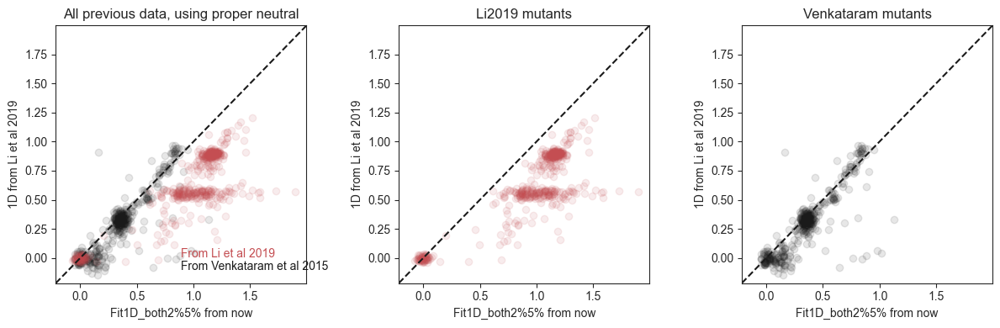

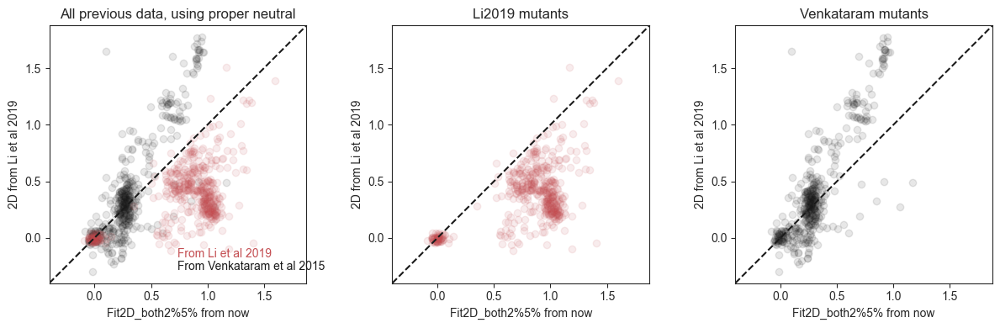

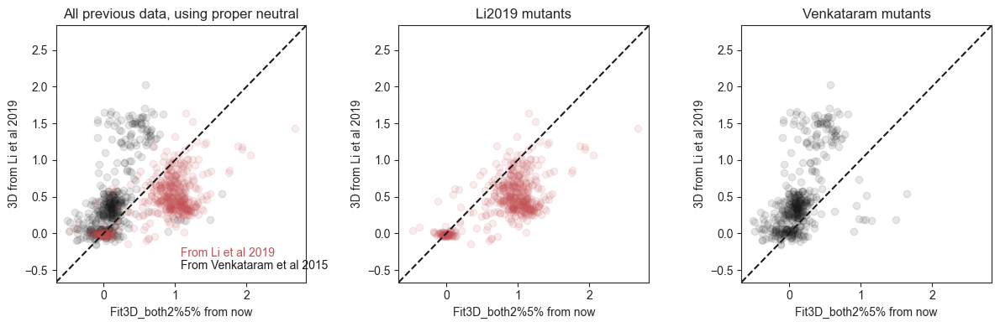

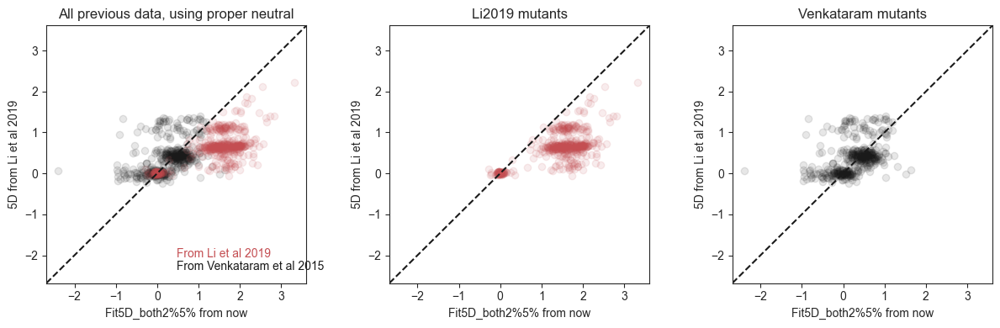

In [41]:
colors = ['b' if source=='This_study' else 'r' if source=='Li2019' else 'orange' if source == 'Aggeli2020' else 'k' for source in merged_fitness['source_publication']]

these_conditions = ['Fit1D-2%','Fit1D-5%','Fit2D-2%','Fit2D-5%','Fit3D_both2%5%','Fit5D_both2%5%']
these_conditions = ['Fit1D_both2%5%','Fit2D_both2%5%','Fit3D_both2%5%','Fit5D_both2%5%']
for condition in these_conditions:
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    
    onlyVen = merged_fitness[merged_fitness['source_publication']=='Venkataram2015']
    plt.scatter(onlyVen[f'{condition}_fitness'].values,onlyVen[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='k')
    
    onlyLi = merged_fitness[merged_fitness['source_publication']=='Li2019']
    plt.scatter(onlyLi[f'{condition}_fitness_Li2019Neutrals'].values,onlyLi[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='r')


    
    plt.title('All previous data, using proper neutral')
#     plt.scatter(merged_fitness[f'{condition}_fitness'].values,merged_fitness[f'{condition.replace("Fit","")}_Fitness_Li2019'].values,alpha=0.1,color=colors)
    plt.xlabel(f'{condition} from now')
    plt.ylabel(f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")} from Li et al 2019')
    
    xmin,xmax = plt.xlim()
    ymin,ymax = plt.ylim()
    new_min = np.min([xmin,ymin])
    new_max = np.max([xmax,ymax])
    
    plt.xlim(new_min,new_max)
    plt.ylim(new_min,new_max)
    plt.plot([new_min,new_max],[new_min,new_max],'k--')
    
    plt.text(s='From Li et al 2019',color='r',x=0.5,y=0.1,transform=plt.gca().transAxes)
    plt.text(s='From Venkataram et al 2015',color='k',x=0.5,y=0.05,transform=plt.gca().transAxes)
    
#     if condition == 'Fit1D':
#         plt.plot([new_min,new_max],[new_min+0.3,new_max+0.3],'r')
        
    plt.subplot(1,3,2)
    plt.title('Li2019 mutants')
    onlyLi = merged_fitness[merged_fitness['source_publication']=='Li2019']
    plt.scatter(onlyLi[f'{condition}_fitness_Li2019Neutrals'].values,onlyLi[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='r')
    plt.xlabel(f'{condition} from now')
    plt.ylabel(f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")} from Li et al 2019')
    

    
    plt.xlim(new_min,new_max)
    plt.ylim(new_min,new_max)
    plt.plot([new_min,new_max],[new_min,new_max],'k--')
    
    plt.subplot(1,3,3)
    plt.title('Venkataram mutants')
    onlyVen = merged_fitness[merged_fitness['source_publication']=='Venkataram2015']
    plt.scatter(onlyVen[f'{condition}_fitness'].values,onlyVen[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")}_Fitness_Li2019'].values,alpha=0.1,color='k')
    plt.xlabel(f'{condition} from now')
    plt.ylabel(f'{condition.replace("Fit","").replace("-2%","").replace("-5%","").replace("_both2%5%","")} from Li et al 2019')
    
    plt.xlim(new_min,new_max)
    plt.ylim(new_min,new_max)
    plt.plot([new_min,new_max],[new_min,new_max],'k--')
    
    plt.tight_layout()
#     plt.savefig(f'plots/{condition}_now_vs_Li2019_comparision.pdf',bbox_inches='tight')
    

    
#     plt.axis('equal')

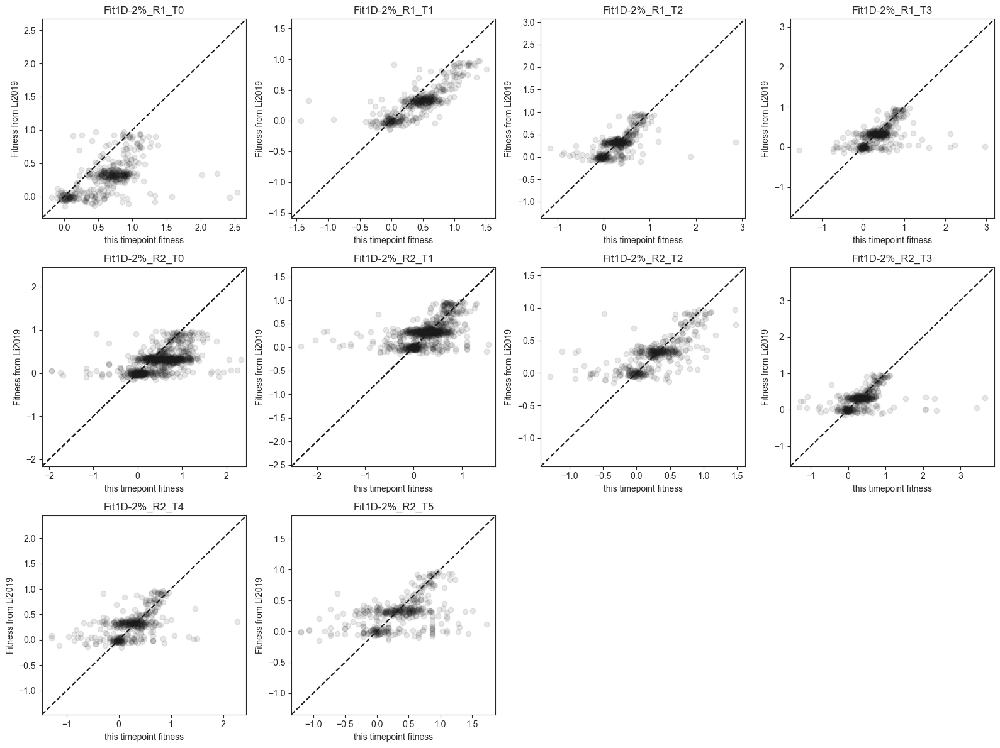

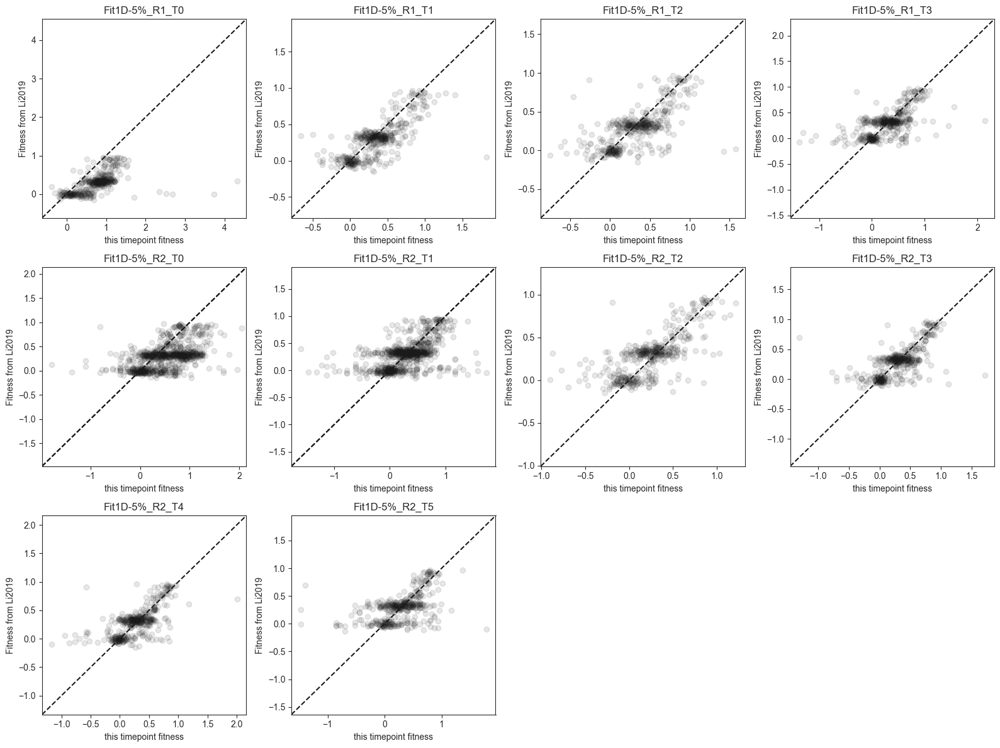

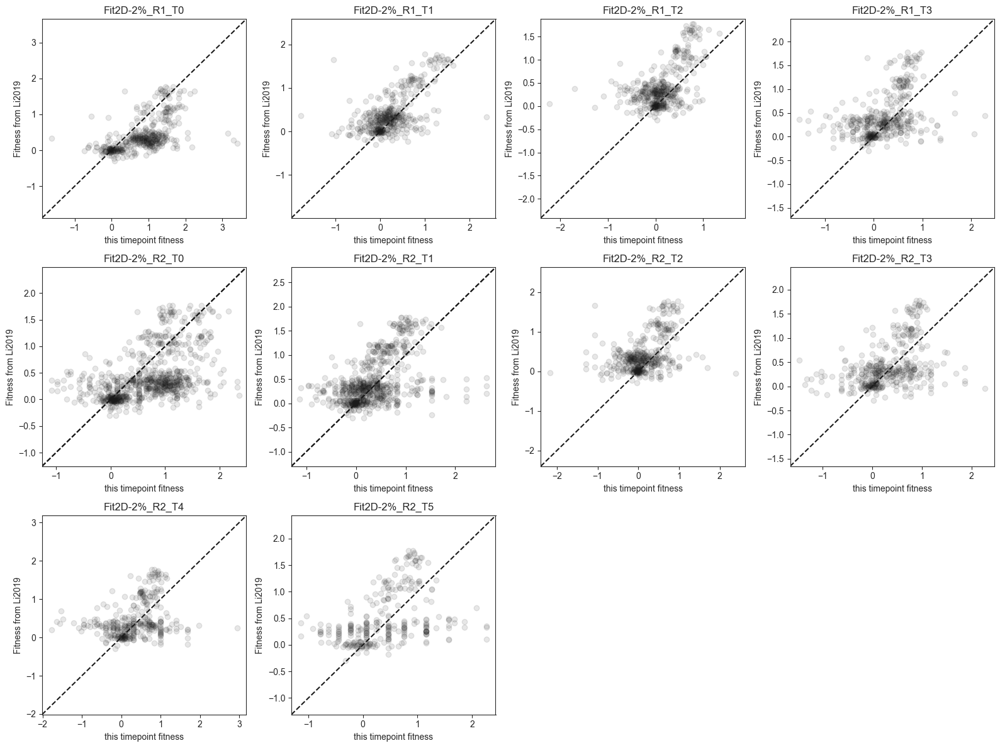

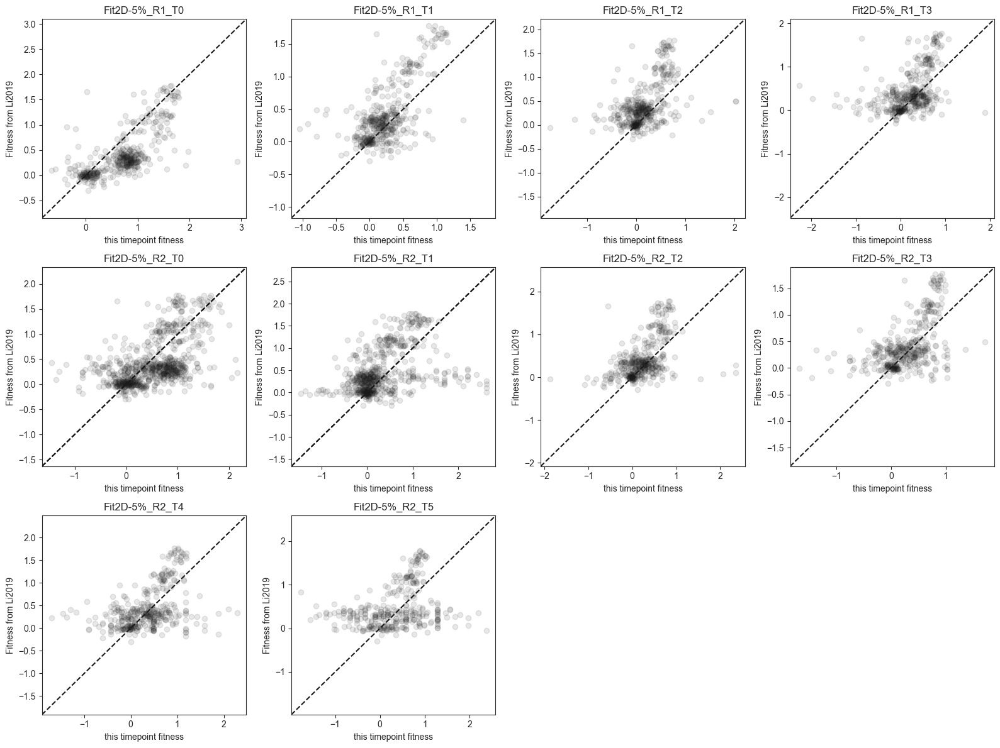

In [42]:
onlyVen = time_fitness[time_fitness['source_publication']=='Venkataram2015']
these_conditions = ['Fit1D-2%','Fit1D-5%','Fit2D-2%','Fit2D-5%']
for condition in these_conditions:
    plt.figure(figsize=(16,12))

    for rep in replicates[condition]:
        for timepoint in range(timepoints[condition]-1):
            plt.subplot(3,4,(rep-1)*4+timepoint+1)

            this_entry = f'{condition}_R{rep}_T{timepoint}'

            plt.title(this_entry)

            plt.scatter(onlyVen[this_entry].values,onlyVen[f'{condition.replace("Fit","").replace("-2%","").replace("-5%","")}_Fitness_Li2019'].values,alpha=0.1,color='k')

            xmin,xmax = plt.xlim()
            ymin,ymax = plt.ylim()
            new_min = np.min([xmin,ymin])
            new_max = np.max([xmax,ymax])

            plt.xlim(new_min,new_max)
            plt.ylim(new_min,new_max)
            plt.plot([new_min,new_max],[new_min,new_max],'k--')

            plt.xlabel('this timepoint fitness')
            plt.ylabel('Fitness from Li2019')
    plt.tight_layout()

#     plt.savefig(f'{condition}_timepoint_x_timepoint_vs_li2019.pdf',bbox_inches='tight')

In [43]:
frac_adaptive_reps = {'Fit1D-2%_R1':[0.01679654,0.03877816,0.0990744,0.18502084,0.32561373,0.50026468
,0.69720261],
'Fit1D-2%_R2':[0.01679654,0.03859004,0.08290013,0.18620736,0.31844365,0.50774083
,0.69366423],
'Fit1D-5%_R1':[0.04097484,0.08988761,0.1991138,0.34681058,0.53028763,0.70083547
,0.83061269],
'Fit1D-5%_R2':[0.04097484,0.0880502,0.17334594,0.33556184,0.52362674,0.69669833
,0.83889647],
'Fit2D-2%_R1':[0.01668408,0.0982661,0.30497456,0.5236933,0.74382209,0.9023462
,0.95886954],
'Fit2D-2%_R2':[0.01668408,0.10184081,0.28765664,0.49013391,0.72125725,0.8753872
,0.9484072,],
'Fit2D-5%_R1':[0.04208657,0.20414912,0.42310295,0.58388309,0.78180444,0.90293329
,0.95946741],
'Fit2D-5%_R2':[0.04208657,0.21964882,0.43290299,0.64120282,0.82724961,0.93431873
,0.97410066],
'Fit3D-2%_R1':[0.018308,0.09202843,0.17297361],
'Fit3D-2%_R2':[0.018308,0.09726202,0.2250882],
'Fit3D-2%_R3':[0.018308,0.10310157,0.19714161],
'Fit3D-5%_R1':[0.0446738,0.10359838,0.24730583],
'Fit3D-5%_R2':[0.0446738,0.12810736,0.19830512],
'Fit3D-5%_R3':[0.0446738,0.1097519,0.228535],
'Fit5D-2%_R1':[0.02352938,0.08874431,0.17179893],
'Fit5D-2%_R2':[0.02352938,0.08752374,0.14778216],
'Fit5D-2%_R3':[0.02352938,0.10128654,0.16266239],
'Fit5D-5%_R1':[0.05331967,0.13788072,0.23298771],
'Fit5D-5%_R2':[0.05331967,0.14633287,0.31351367],
'Fit5D-5%_R3':[0.05331967,0.1387983,0.56573556]}

frac_adaptive = {}
for condition in ['Fit1D-2%','Fit1D-5%',
                  'Fit2D-2%','Fit2D-5%',
                  'Fit3D-2%','Fit3D-5%',
                  'Fit5D-2%','Fit5D-5%']:
    fracs = []
    for rep in replicates[condition]:
        fracs.append(frac_adaptive_reps[f'{condition}_R{rep}'])
    frac_adaptive[condition] = np.mean(fracs,axis=0)

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

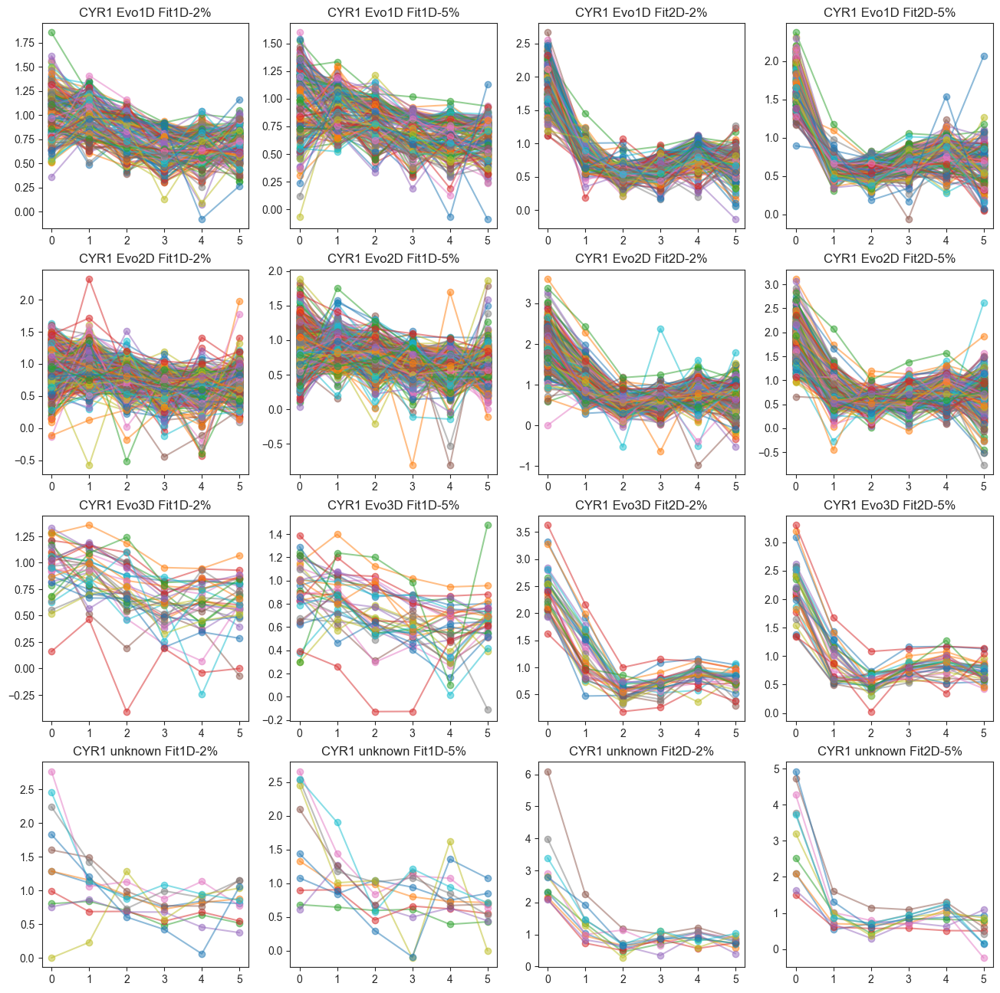

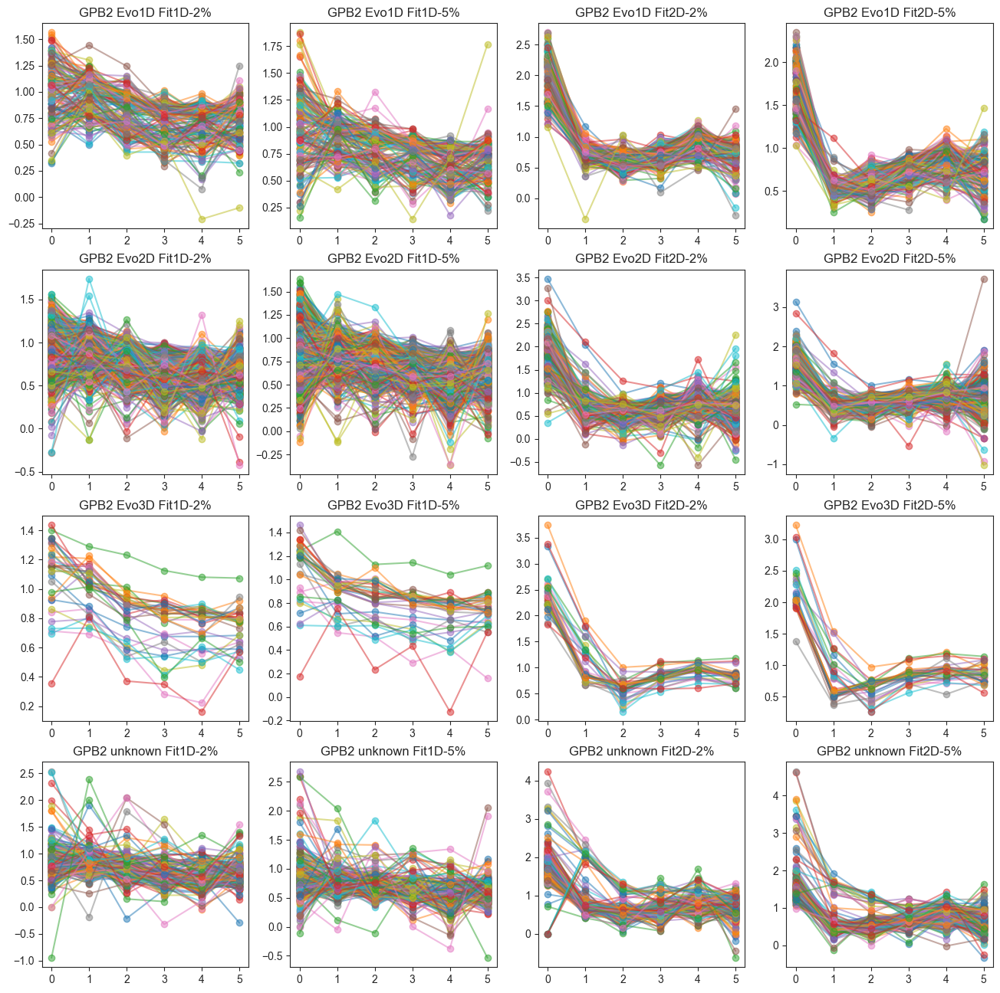

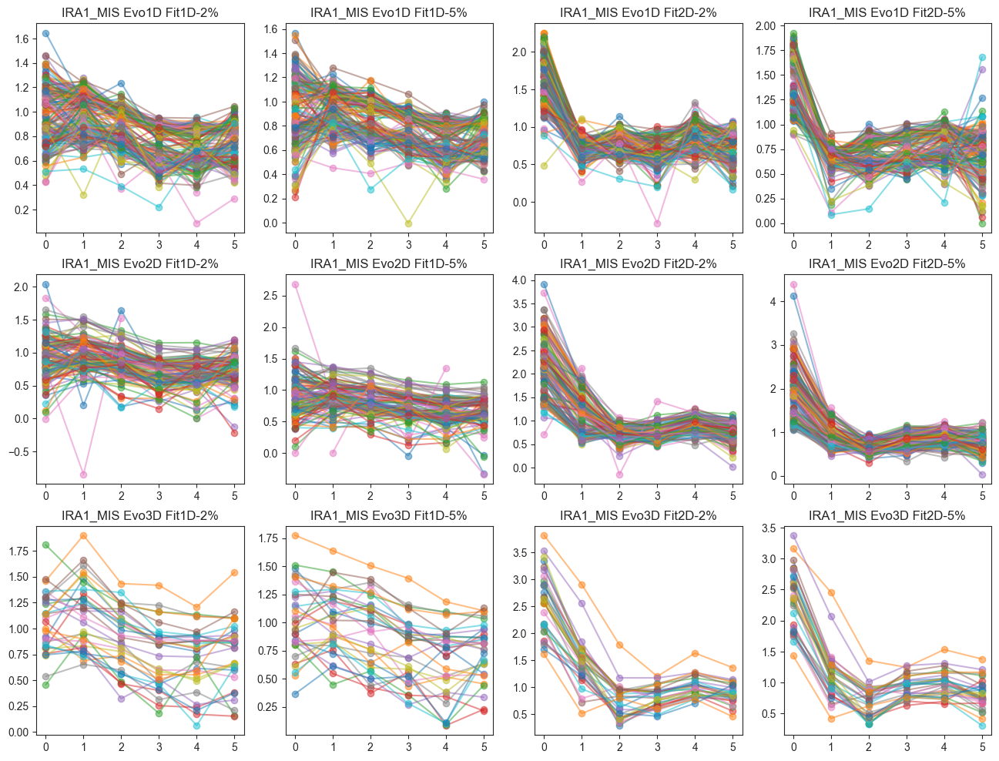

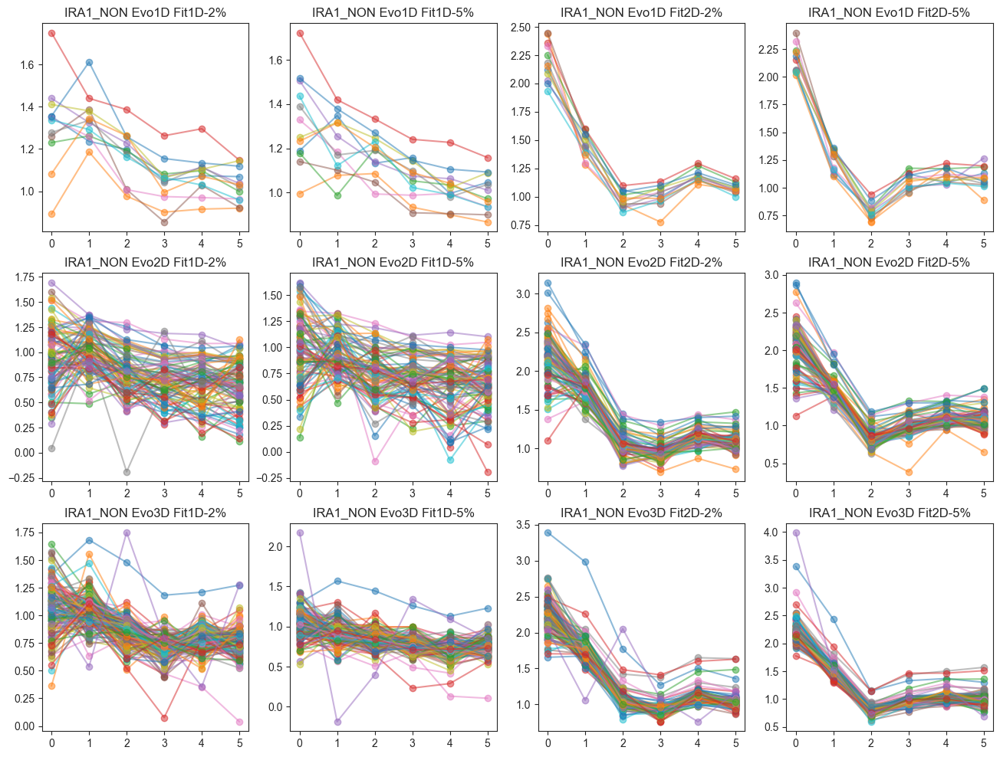

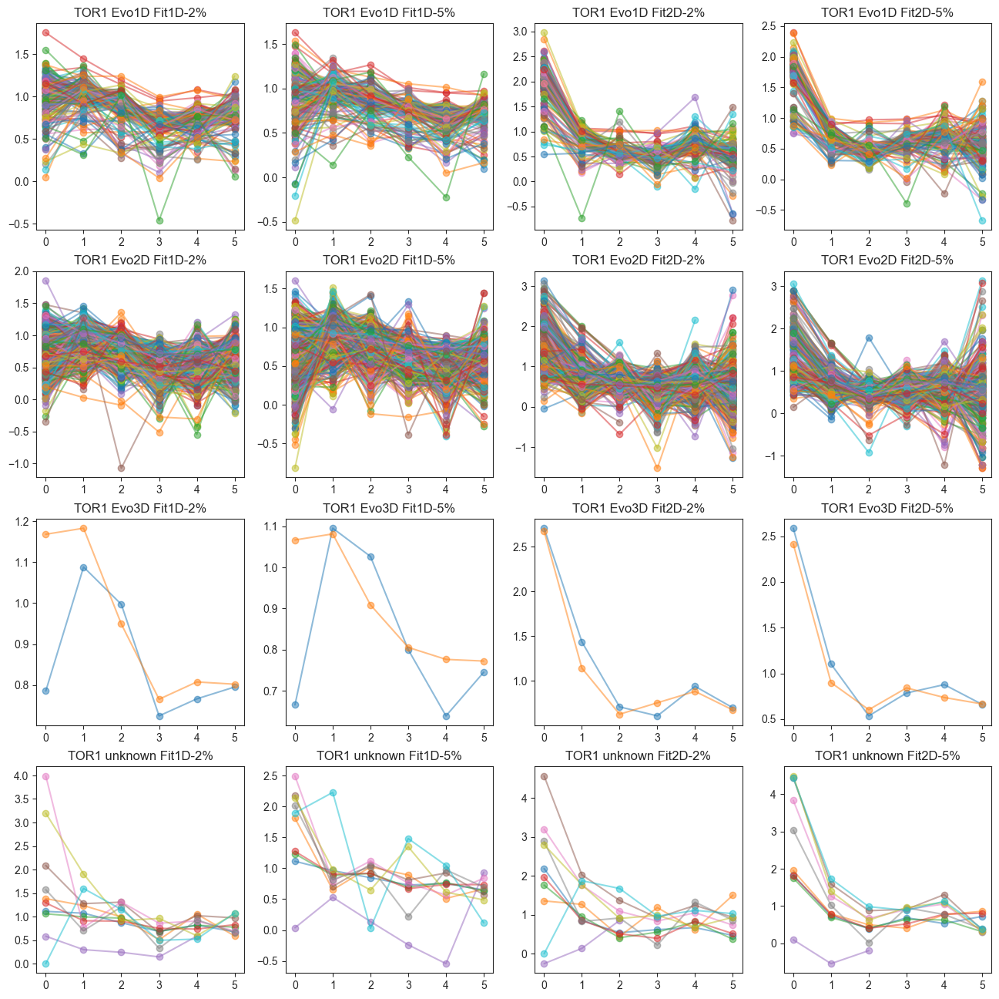

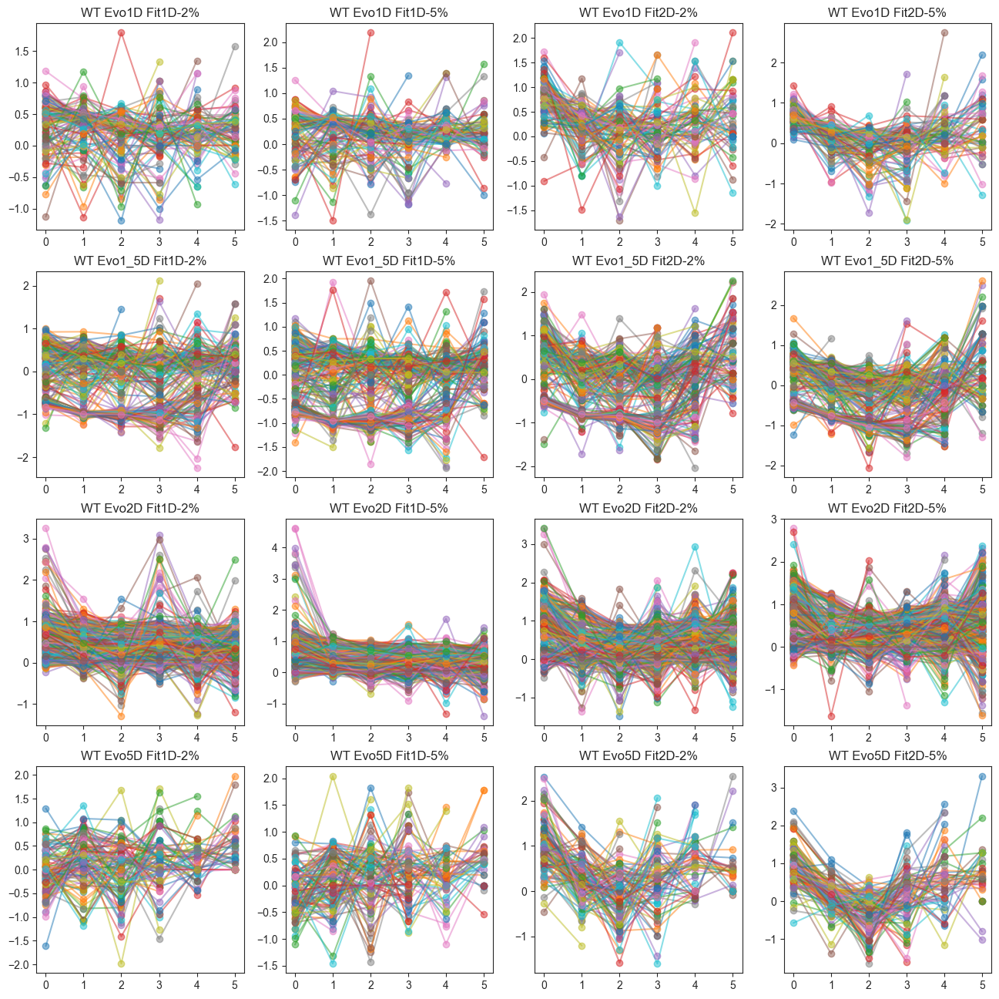

In [44]:
evo_colors = {'Evo1D':'b',
              'Evo2D':'r',
              'Evo3D':'g',
              'Evo5D':'m',
              'unknown':'gray',
             }


# conditions = ['Fit1D_both2%5%','Fit2D_both2%5%','Fit3D_both2%5%','Fit5D_both2%5%']

these_conditions = ['Fit1D-2%','Fit1D-5%','Fit2D-2%','Fit2D-5%']
for anc in np.unique(merged_fitness['ancestor'].values):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
    plt.figure(figsize=(len(these_conditions)*4,4*len(np.unique(this_anc['evolution_condition'].values))))
    for e,evo_cond in enumerate(np.unique(this_anc['evolution_condition'].values)):
        
        this_anc_indices = np.where((merged_fitness['ancestor']==anc)&(merged_fitness['evolution_condition']==evo_cond))[0]


        for c,condition in enumerate(these_conditions):

            plt.subplot(len(np.unique(this_anc['evolution_condition'].values)),4,e*4+c+1)
            plt.title(f'{anc} {evo_cond} {condition}')
            
            
#             rep = replicates[condition][0]
#             these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
#             these_es = [f+'_error' for f in these_fs]
            
#             avg_time_fitness = time_fitness[these_fs].values
# #             avg_time_error = 
            
#             for rep in replicates[condition][1:]:
#                 these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
#                 these_es = [f+'_error' for f in these_fs]
#                 avg_time_fitness += time_fitness[these_fs].values
#             avg_time_fitness = avg_time_fitness/len(replicates[condition])

            
            fs_here = []
            es_here = []
            for rep in replicates[condition]:
            
                these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
                these_es = [f+'_error' for f in these_fs]
                
                fs_here.append(time_fitness[these_fs].values)
                es_here.append(time_fitness[[f+'_error' for f in these_fs]].values)

            
            avg_time_fitness,avg_time_error = tools.inverse_variance_mean(fs_here,es_here,axis=0)
#             avg_time_fitness = time_fitness[these_fs].values
#             avg_time_error = 
            
#             for rep in replicates[condition][1:]:
#                 these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
#                 these_es = [f+'_error' for f in these_fs]
#                 avg_time_fitness += time_fitness[these_fs].values
#             avg_time_fitness = avg_time_fitness/len(replicates[condition])
                
            plt.plot(avg_time_fitness[this_anc_indices,:].swapaxes(0,1),marker='o',alpha=0.5)


            
#             for rep in replicates[condition]:
#                 plt.subplot(len(np.unique(this_anc['evolution_condition'].values)),8,e*8+c*2+rep)
#                 plt.title(f'{anc} {evo_cond} {condition} R{rep}')
#                 these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]

#                 t0_repeated = np.repeat(time_fitness[these_fs].values[:,0],timepoints[condition]-1).reshape(time_fitness[these_fs].shape)
#                 delta_0 = time_fitness[these_fs].values-t0_repeated
#     #             plt.plot(delta_0[this_anc_indices,:])

#                 plt.plot(time_fitness[these_fs].values[this_anc_indices,:].swapaxes(0,1),marker='o',alpha=0.5)

#     plt.savefig(f'plots/{anc}_time_fitness_avgcondition.pdf',bbox_inches='tight')



/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

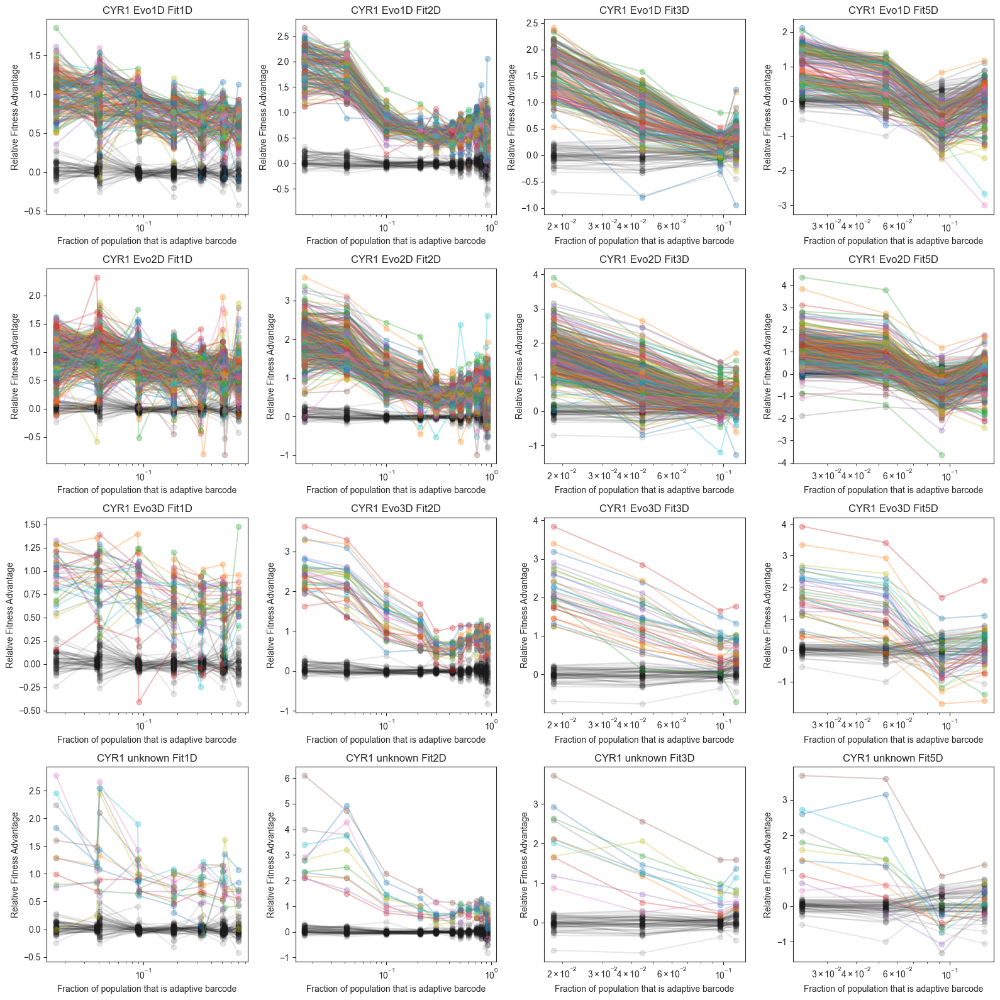

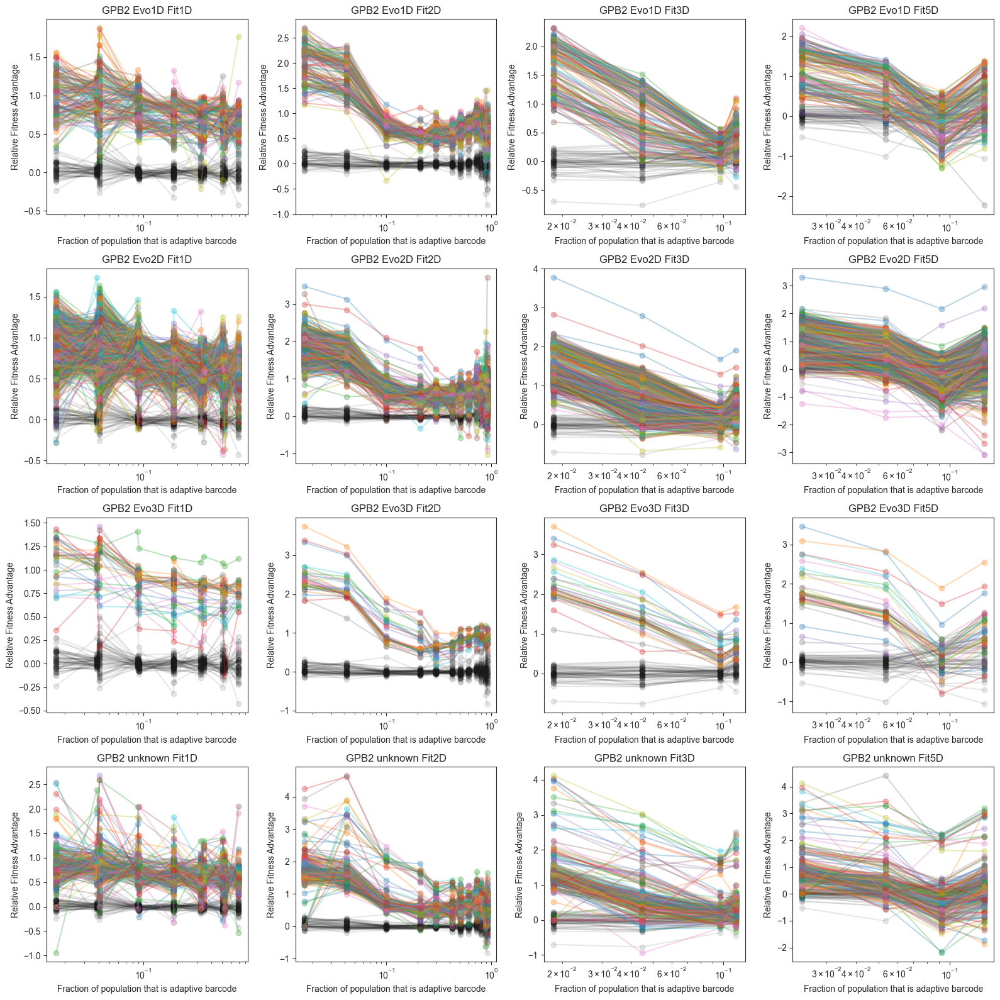

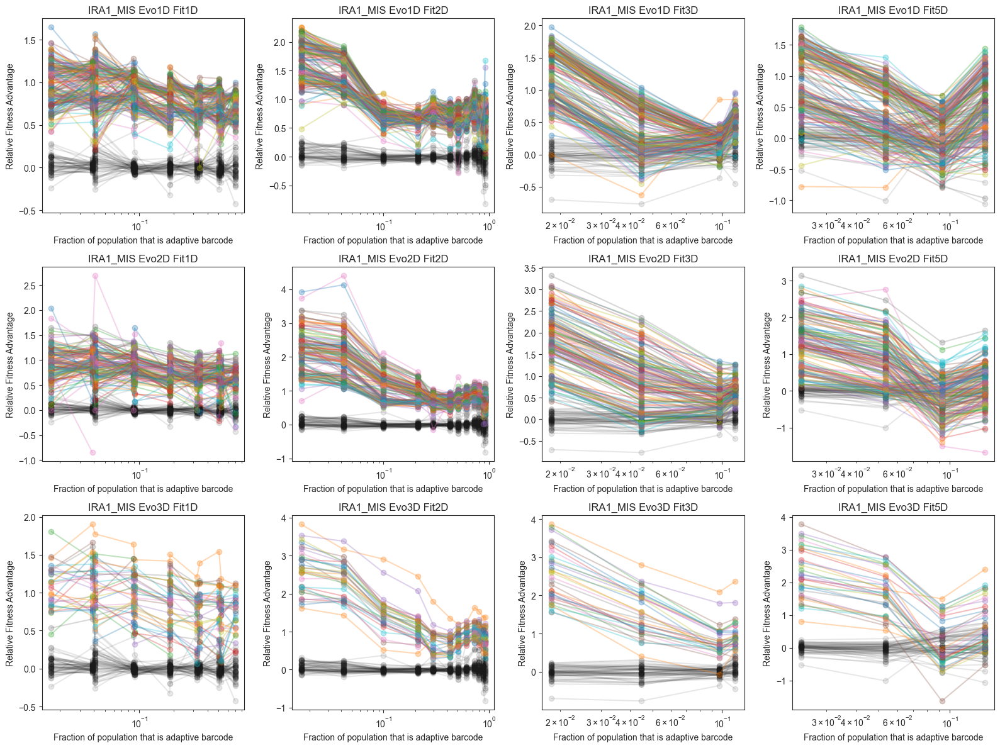

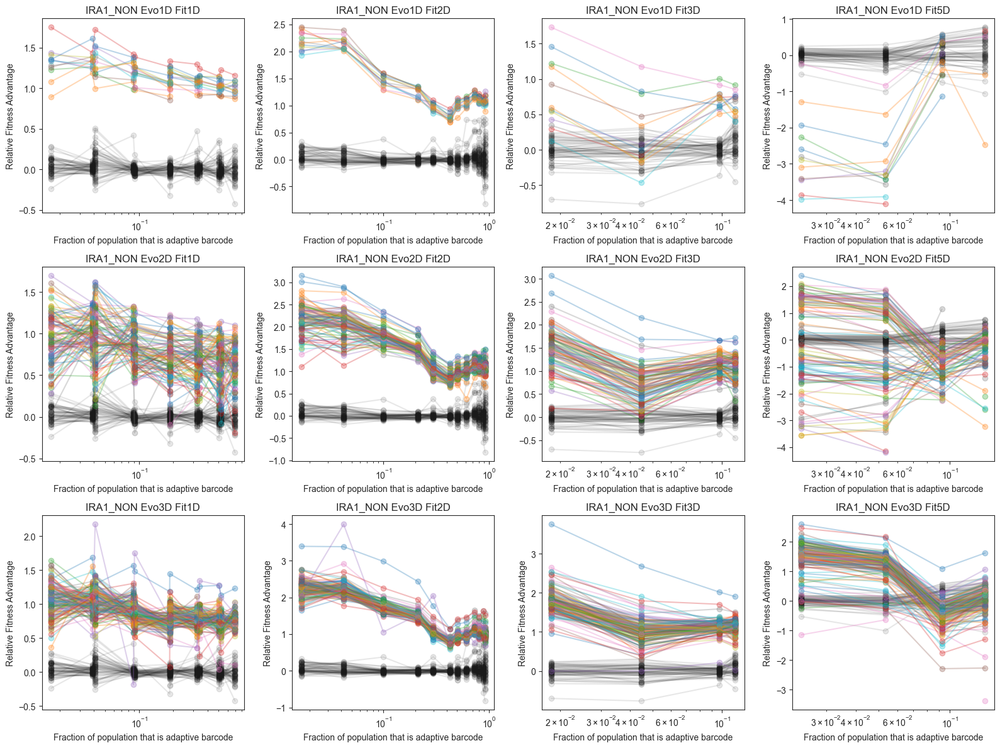

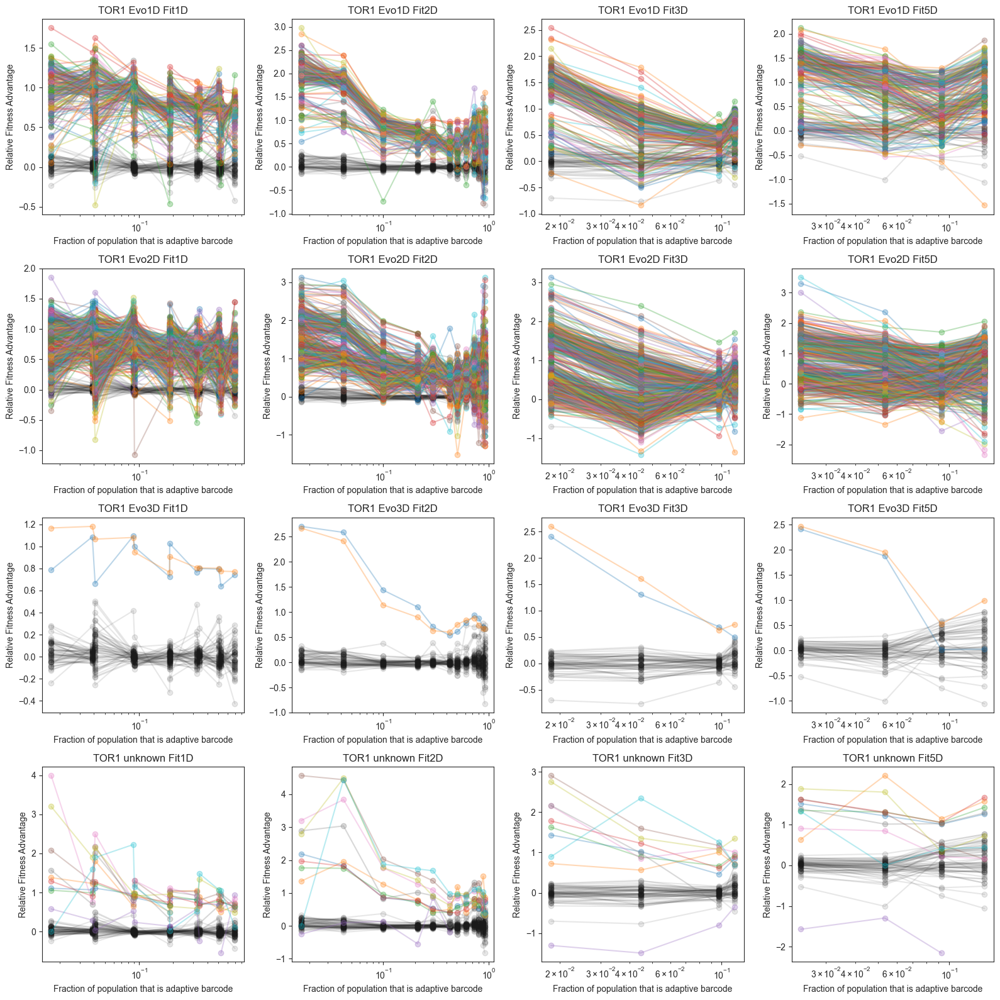

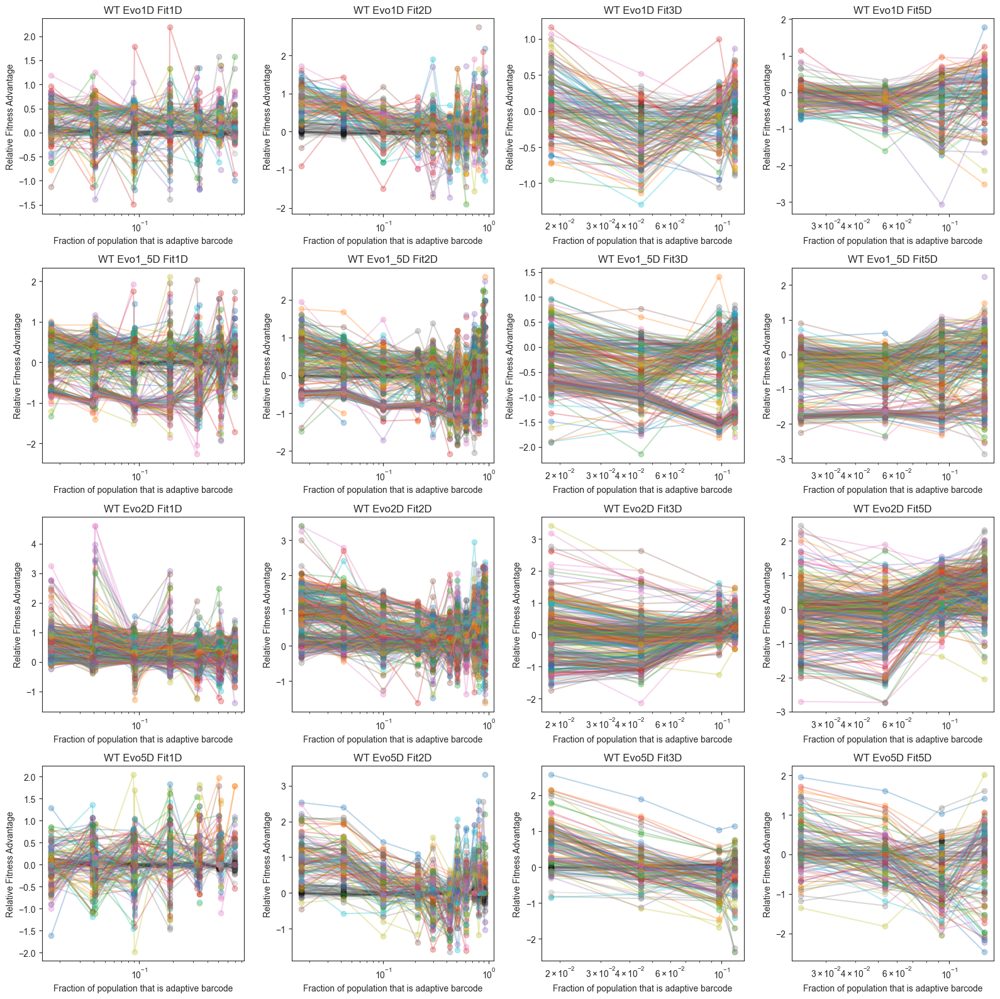

In [45]:
evo_colors = {'Evo1D':'b',
              'Evo2D':'r',
              'Evo3D':'g',
              'Evo5D':'m',
              'unknown':'gray',
             }


# conditions = ['Fit1D_both2%5%','Fit2D_both2%5%','Fit3D_both2%5%','Fit5D_both2%5%']


these_conditions_dict = {'Fit1D':['Fit1D-2%','Fit1D-5%'],
                         'Fit2D':['Fit2D-2%','Fit2D-5%'],
                        'Fit3D':['Fit3D-2%','Fit3D-5%'],
                        'Fit5D':['Fit5D-2%','Fit5D-5%']}
# these_conditions_dict = {'Fit1D':['Fit1D-2%','Fit1D-5%'],
#                          'Fit2D':['Fit2D-2%','Fit2D-5%']}


neutral_indices = np.where((merged_fitness['barcode'].isin(handpicked_neutrals)))[0]

for anc in np.unique(merged_fitness['ancestor'].values):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
    plt.figure(figsize=(4*4,4*len(np.unique(this_anc['evolution_condition'].values))))
    for e,evo_cond in enumerate(np.unique(this_anc['evolution_condition'].values)):
        
        this_anc_indices = np.where((merged_fitness['ancestor']==anc)&(merged_fitness['evolution_condition']==evo_cond))[0]

        for c,(condition_name,these_conditions) in enumerate(these_conditions_dict.items()):
            to_plot = []
            frac_here = []
            plt.subplot(len(np.unique(this_anc['evolution_condition'].values)),len(these_conditions_dict.keys()),e*len(these_conditions_dict.keys())+c+1)
            plt.title(f'{anc} {evo_cond} {condition_name}')
            
            for condition in these_conditions:
                f_to_avg = []
                e_to_avg = []

                for rep in replicates[condition]:
                    these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
                    these_es = [f+'_error' for f in these_fs]
                    f_to_avg.append(time_fitness[these_fs].values)
                    e_to_avg.append(time_fitness[these_es].values)
            #                 avg_time_fitness = avg_time_fitness/len(replicates[condition])
                avg_time_fitness,avg_time_error = tools.inverse_variance_mean(np.asarray(f_to_avg),np.asarray(e_to_avg),axis=0)
                to_plot.append(avg_time_fitness)
                frac_here.append(frac_adaptive[condition][:-1])
        
        
            new_plotting = np.empty((avg_time_fitness.shape[0],len(replicates[condition])*avg_time_fitness.shape[1]))
            new_plotting[:] = np.nan

            order = np.dstack(np.unravel_index(np.argsort(np.asarray(frac_here).ravel()), np.asarray(frac_here).shape))[0]

            frac_list = []
            for l,(x,y) in enumerate(order):
                new_plotting[:,l] = np.asarray(to_plot)[x,:,y]
                frac_list.append(np.asarray(frac_here)[x,y])
            
            plt.plot(frac_list,new_plotting[neutral_indices,:len(frac_list)].swapaxes(0,1),marker='o',color='k',alpha=0.1)
            plt.plot(frac_list,new_plotting[this_anc_indices,:len(frac_list)].swapaxes(0,1),marker='o',alpha=0.3)
            
            
            plt.ylabel('Relative Fitness Advantage')
            plt.xlabel('Fraction of population that is adaptive barcode')
            plt.xscale('log')
            
            
    plt.tight_layout()       
#     plt.savefig(f'plots/{anc}_time_fitness_avgcondition_fracadaptive_withneutrals.pdf',bbox_inches='tight')




In [46]:
merged_fitness

,Fit1D-2%-R1_fitness,Fit1D-2%-R1_error,Fit1D-2%-R2_fitness,Fit1D-2%-R2_error,Fit1D-5%-R1_fitness,Fit1D-5%-R1_error,Fit1D-5%-R2_fitness,Fit1D-5%-R2_error,Fit2D-2%-R1_fitness,Fit2D-2%-R1_error,...,Fit2D_both2%5%_fitness_Li2019Neutrals,Fit2D_both2%5%_error_Li2019Neutrals,Fit3D_both2%5%_fitness,Fit3D_both2%5%_error,Fit3D_both2%5%_fitness_Li2019Neutrals,Fit3D_both2%5%_error_Li2019Neutrals,Fit5D_both2%5%_fitness,Fit5D_both2%5%_error,Fit5D_both2%5%_fitness_Li2019Neutrals,Fit5D_both2%5%_error_Li2019Neutrals
0,0.770538,0.056064,0.798667,0.056490,0.793227,0.037792,0.777312,0.034586,1.152181,0.032200,...,1.883898,0.017769,1.552972,0.052341,2.583981,0.052341,1.224707,0.062951,2.978928,0.062951
1,0.938763,0.035535,1.009834,0.036124,0.936852,0.024449,0.940881,0.024295,1.721427,0.024800,...,2.370876,0.014468,3.124871,0.029720,4.151767,0.029720,2.945852,0.034956,4.686098,0.034956
2,0.850726,0.053260,0.837848,0.056183,0.847252,0.039778,0.851379,0.033796,1.230381,0.030045,...,1.974673,0.017027,2.209557,0.044930,3.238917,0.044930,2.050791,0.050844,3.807420,0.050844
3,1.074590,0.049368,1.048208,0.050017,0.913976,0.039413,0.963205,0.035169,1.364335,0.032921,...,2.082406,0.018237,1.416678,0.075140,2.450472,0.075140,-0.229300,0.258695,1.506701,0.258695
4,0.931656,0.050006,0.962649,0.052219,0.851260,0.038401,0.939050,0.034383,1.111230,0.035139,...,1.820916,0.019590,1.688100,0.061451,2.717293,0.061451,2.083678,0.064446,3.852562,0.064446
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5021,0.388302,0.833230,0.405459,0.622680,0.182802,0.424601,0.998668,0.298171,0.726315,0.660909,...,1.326408,0.298048,0.111080,0.963457,1.151594,0.963457,0.575905,0.959078,2.310693,0.959078
5022,0.779675,0.079662,0.802178,0.078588,0.714047,0.057034,0.810990,0.048184,0.713101,0.114501,...,1.414582,0.049285,0.668848,0.144437,1.707793,0.144437,0.839425,0.159220,2.601292,0.159220
5023,0.482098,0.188088,0.630145,0.145766,0.495766,0.132897,0.457116,0.097001,0.576438,0.270611,...,1.247043,0.103618,0.559253,0.254961,1.598812,0.254961,0.366615,0.280315,2.120474,0.280315
5024,0.822036,0.084740,0.806927,0.090888,0.685954,0.066067,0.751837,0.054305,0.704487,0.129870,...,1.396007,0.059379,0.558246,0.189933,1.604822,0.189933,0.573966,0.219226,2.334107,0.219226


/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/var/folders/9y/6d7h4kvn6f989_h_gypc_j_00000gn/T/ipykernel_1342/1371075076.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(4*4,4))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in d

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))


[0.02352938, 0.053319670000000007, 0.09251819666666666, 0.14100396333333334]
[[ 2.03013156e+00  1.50978281e+00 -4.61107726e-01  3.20288640e-03
              nan             nan]
 [ 3.30233504e+00  2.89850629e+00  2.16063457e+00  2.94997709e+00
              nan             nan]
 [ 2.62231652e+00  2.26949344e+00  1.00374695e+00  1.09779935e+00
              nan             nan]
 ...
 [-1.74106985e-01  1.48038343e-02  4.79089432e-01  1.06833784e+00
              nan             nan]
 [ 9.45172219e-01  6.62175144e-01  2.41400612e-01  7.53706568e-01
              nan             nan]
 [-6.37457114e-01 -7.03104245e-01 -7.56506439e-01             nan
              nan             nan]]


/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/Evol

[0.01679654, 0.0386841, 0.04097484, 0.088968905, 0.09098726500000001, 0.1856141, 0.18622987000000002, 0.32202869, 0.34118621, 0.504002755, 0.526957185, 0.6987669000000001]
[[ 0.95275663  0.83739292  0.9894978  ...  0.79113715  0.75232537
   0.74783472]
 [ 1.01561087  1.21756457  1.07730386 ...  0.88276735  0.89003926
   0.98746176]
 [ 1.07060324  1.01167663  0.95637275 ...  0.80154093  0.78819489
   0.80038431]
 ...
 [ 0.67647463  0.75030205  0.76840199 ...  0.45058532  0.31745676
   0.56548025]
 [ 0.93528339  1.04074107  0.7748293  ...  0.89213372  0.72998976
   0.64819588]
 [-0.34468529  1.27508119 -0.20174248 ...  1.09861229  0.69792046
   0.        ]]
[0.01668408, 0.04208657, 0.100053455, 0.21189897, 0.2963156, 0.42800297, 0.506913605, 0.612542955, 0.73253967, 0.8045270250000001, 0.8888667, 0.91862601]
[[2.85471099 2.75218794 1.74043672 ... 1.04666936 0.96913953 1.06723877]
 [3.47379567 3.13503692 2.0346389  ... 1.05413329 1.01547512 1.04539488]
 [3.31550046 3.0835373  1.92146044 .

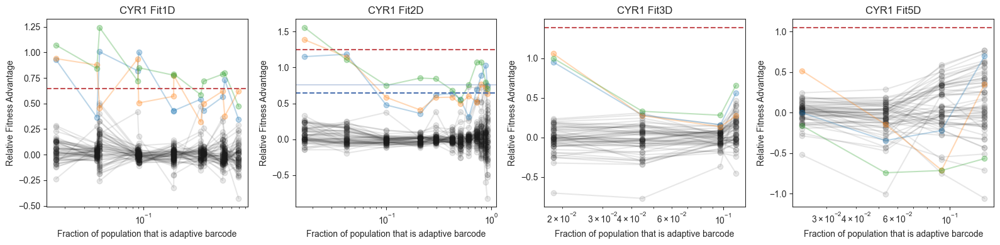

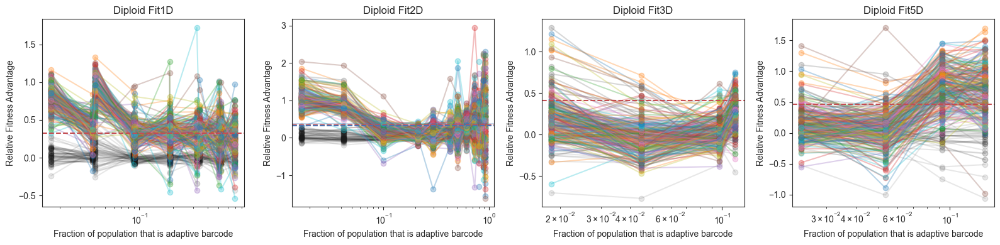

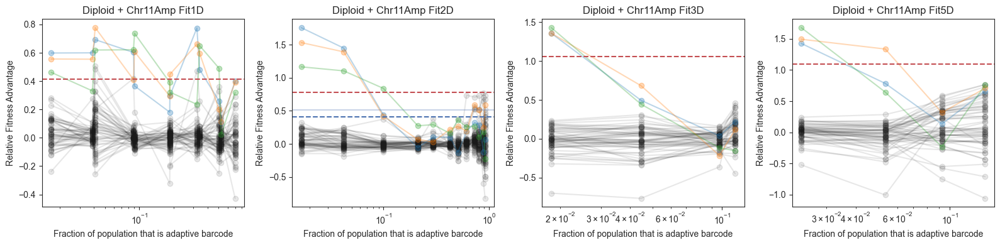

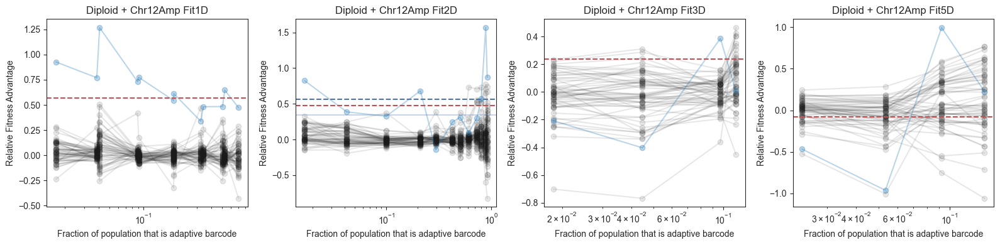

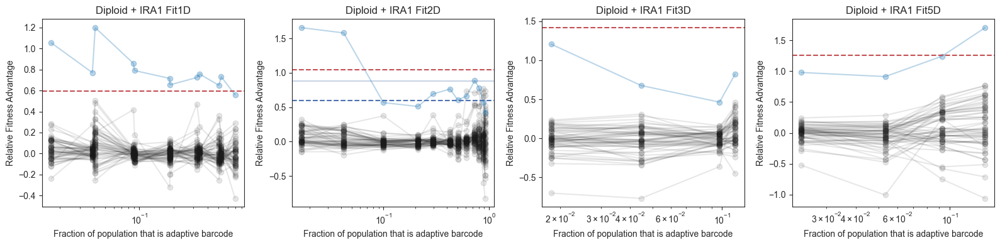

...

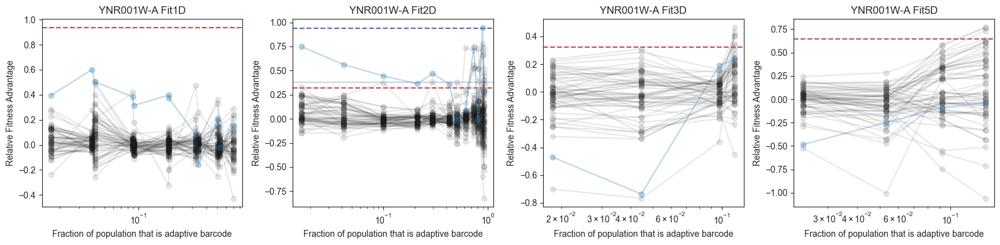

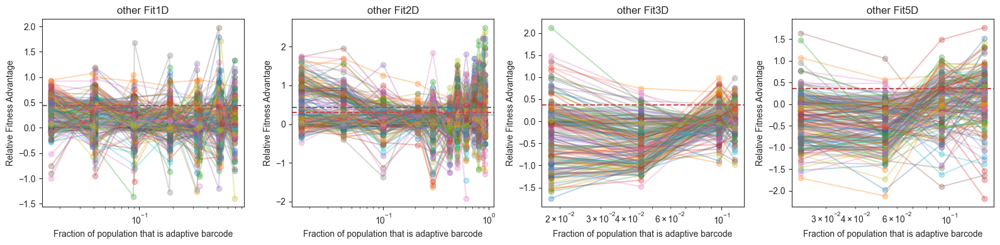

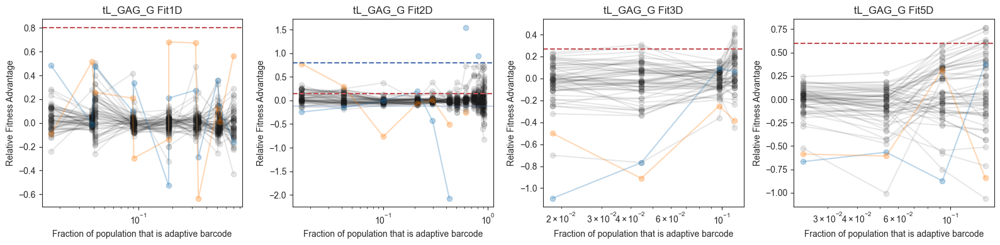

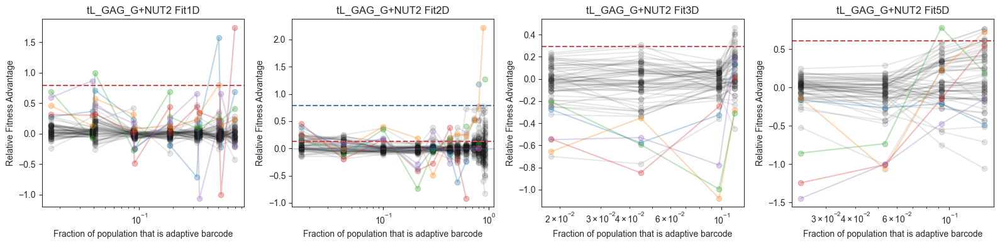

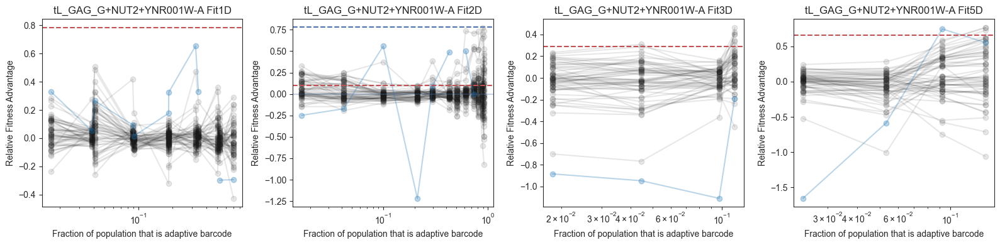

In [49]:
evo_colors = {'Evo1D':'b',
              'Evo2D':'r',
              'Evo3D':'g',
              'Evo5D':'m',
              'unknown':'gray',
             }


# conditions = ['Fit1D_both2%5%','Fit2D_both2%5%','Fit3D_both2%5%','Fit5D_both2%5%']


these_conditions_dict = {'Fit1D':['Fit1D-2%','Fit1D-5%'],
             'Fit2D':['Fit2D-2%','Fit2D-5%']}
these_conditions_dict = {'Fit1D':['Fit1D-2%','Fit1D-5%'],
                         'Fit2D':['Fit2D-2%','Fit2D-5%'],
                        'Fit3D':['Fit3D-2%','Fit3D-5%'],
                        'Fit5D':['Fit5D-2%','Fit5D-5%']}


neutral_indices = np.where((merged_fitness['barcode'].isin(handpicked_neutrals)))[0]

wt_data = merged_fitness[merged_fitness['ancestor']=='WT']

for gene in np.unique(wt_data['gene'].values):
    this_gene_bcs = wt_data[wt_data['gene']==gene]['barcode'].values
    this_gene_indices = np.where(merged_fitness['barcode'].isin(this_gene_bcs))[0]
    
    plt.figure(figsize=(4*4,4))
        
    

    for c,(condition_name,these_conditions) in enumerate(these_conditions_dict.items()):
        to_plot = []
        frac_here = []
        plt.subplot(1,len(these_conditions_dict.keys()),c+1)
        plt.title(f'{gene} {condition_name}')

        for condition in these_conditions:
            f_to_avg = []
            e_to_avg = []

            for rep in replicates[condition]:
                these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
                these_es = [f+'_error' for f in these_fs]
                f_to_avg.append(time_fitness[these_fs].values)
                e_to_avg.append(time_fitness[these_es].values)
        #                 avg_time_fitness = avg_time_fitness/len(replicates[condition])
            avg_time_fitness,avg_time_error = tools.inverse_variance_mean(np.asarray(f_to_avg),np.asarray(e_to_avg),axis=0)
            to_plot.append(avg_time_fitness)
            frac_here.append(frac_adaptive[condition][:-1])


        new_plotting = np.empty((avg_time_fitness.shape[0],len(replicates[condition])*avg_time_fitness.shape[1]))
        new_plotting[:] = np.nan

        order = np.dstack(np.unravel_index(np.argsort(np.asarray(frac_here).ravel()), np.asarray(frac_here).shape))[0]

        frac_list = []
        for l,(x,y) in enumerate(order):
            new_plotting[:,l] = np.asarray(to_plot)[x,:,y]
            frac_list.append(np.asarray(frac_here)[x,y])
            
        print(frac_list)
        print(new_plotting)

        plt.plot(frac_list,new_plotting[neutral_indices,:len(frac_list)].swapaxes(0,1),marker='o',color='k',alpha=0.1)
        plt.plot(frac_list,new_plotting[this_gene_indices,:len(frac_list)].swapaxes(0,1),marker='o',alpha=0.3)
        
        old_fitness = merged_fitness[f"{condition_name.replace('Fit','')}_Fitness_Li2019"].values
        plt.axhline(np.nanmean(old_fitness[this_gene_indices]),color='r',linestyle='--')
        
        if condition_name =='Fit2D':
            oneday_fitness = merged_fitness[f"1D_Fitness_Li2019"].values
            plt.axhline(np.nanmean(oneday_fitness[this_gene_indices]),color='b',linestyle='--')
            plt.axhline(np.nanmean(new_plotting[this_gene_indices,:-4].swapaxes(0,1)),color='b',alpha=0.3)

        plt.ylabel('Relative Fitness Advantage')
        plt.xlabel('Fraction of population that is adaptive barcode')
        plt.xscale('log')

            
    plt.tight_layout()       
    plt.savefig(f'{home_dir}/figures/analysis/frequency_dependence/WT_{gene}_time_fitness_avgcondition_fracadaptive_withneutrals.pdf',bbox_inches='tight')





In [63]:
these_conditions = ['Fit2D-2%','Fit2D-5%']
to_plot = []
frac_here = []
for condition in these_conditions:
    rep = replicates[condition][0]
    these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
    these_es = [f+'_error' for f in these_fs]

    avg_time_fitness = time_fitness[these_fs].values

    for rep in replicates[condition][1:]:
        these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
        these_es = [f+'_error' for f in these_fs]
        avg_time_fitness += time_fitness[these_fs].values
    avg_time_fitness = avg_time_fitness/len(replicates[condition])
    to_plot.append(avg_time_fitness)
    frac_here.append(frac_adaptive[condition][:-1])
    
new_plotting = np.empty((avg_time_fitness.shape[0],len(replicates[condition])*avg_time_fitness.shape[1]))
new_plotting[:] = np.nan

order = np.dstack(np.unravel_index(np.argsort(np.asarray(frac_here).ravel()), np.asarray(frac_here).shape))[0]

frac_list = []
for l,(x,y) in enumerate(order):
    new_plotting[:,l] = np.asarray(to_plot)[x,:,y]
    frac_list.append(np.asarray(frac_here)[x,y])
    


In [64]:
to_plot = []
errors = []
frac_here = []
these_conditions = ['Fit2D-2%','Fit2D-5%']
for condition in these_conditions:
    f_to_avg = []
    e_to_avg = []

    for rep in replicates[condition]:
        these_fs = [f'{condition}_R{rep}_T{timepoint}' for timepoint in range(timepoints[condition]-1)]
        these_es = [f+'_error' for f in these_fs]
        f_to_avg.append(time_fitness[these_fs].values)
        e_to_avg.append(time_fitness[these_es].values)
#                 avg_time_fitness = avg_time_fitness/len(replicates[condition])
    avg_time_fitness,avg_time_error = tools.inverse_variance_mean(np.asarray(f_to_avg),np.asarray(e_to_avg),axis=0)
    to_plot.append(avg_time_fitness)
    errors.append(avg_time_error)
    frac_here.append(frac_adaptive[condition][:-1])


new_plotting = np.empty((avg_time_fitness.shape[0],len(replicates[condition])*avg_time_fitness.shape[1]))
new_plotting[:] = np.nan

new_plotting_error = np.empty((avg_time_fitness.shape[0],len(replicates[condition])*avg_time_fitness.shape[1]))
new_plotting_error[:] = np.nan



order = np.dstack(np.unravel_index(np.argsort(np.asarray(frac_here).ravel()), np.asarray(frac_here).shape))[0]

frac_list = []
for l,(x,y) in enumerate(order):
    new_plotting[:,l] = np.asarray(to_plot)[x,:,y]
    new_plotting_error[:,l] = np.asarray(errors)[x,:,y]
    frac_list.append(np.asarray(frac_here)[x,y])
    
# new_plotting

/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:243: RuntimeWarning: invalid value encountered in divide
  weighted_mean = np.nansum(means/variances,axis=axis)/(np.nansum(1/variances,axis=axis))
/Users/grantkinsler/Documents/Stanford/Research/EvolvingFront//code/processing/tools/tools.py:245: RuntimeWarning: divide by zero encountered in reciprocal
  weighted_standard_devs = np.sqrt((np.nansum(1/variances,axis=axis))**(-1))


In [65]:
frac_list

[0.01668408,
 0.04208657,
 0.100053455,
 0.21189897,
 0.2963156,
 0.42800297,
 0.506913605,
 0.612542955,
 0.73253967,
 0.8045270250000001,
 0.8888667,
 0.91862601]

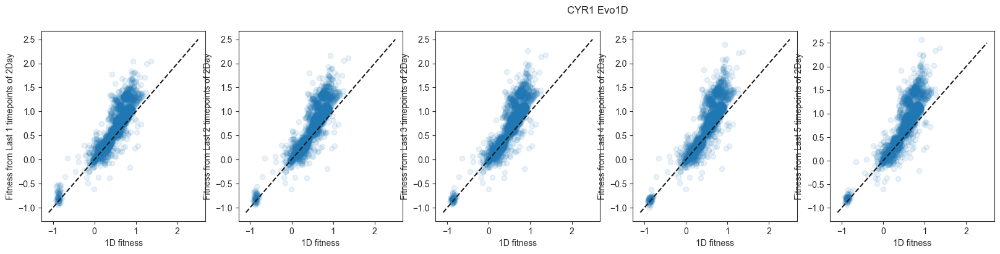

In [66]:
plt.figure(figsize=(6*4,4))
plt.suptitle(f'{anc} {evo_cond}')
for n_to_include in range(1,6):
    plt.subplot(1,6,n_to_include)
    plt.scatter(merged_fitness['Fit1D_both2%5%_fitness'].values,
                np.nanmean(new_plotting[:,:-1*n_to_include],axis=1),
                alpha=0.1)

    plt.plot([-1.1,2.5],[-1.1,2.5],color='k',linestyle='--')
    plt.xlabel('1D fitness')
    plt.ylabel(f'Fitness from Last {n_to_include} timepoints of 2Day')


/var/folders/9y/6d7h4kvn6f989_h_gypc_j_00000gn/T/ipykernel_97552/2584608320.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(len(include_list)*4,4))


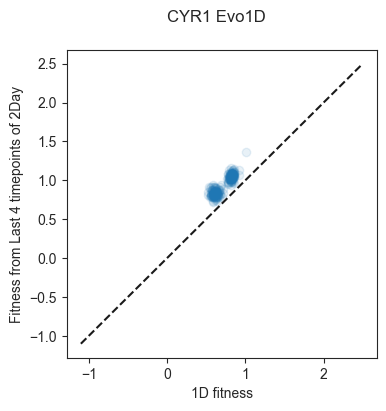

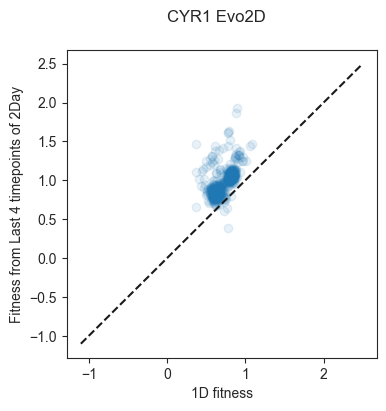

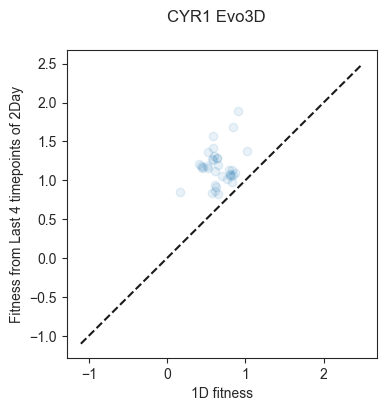

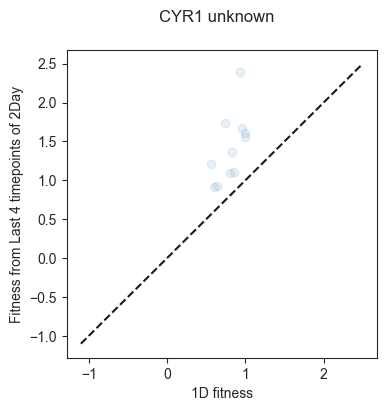

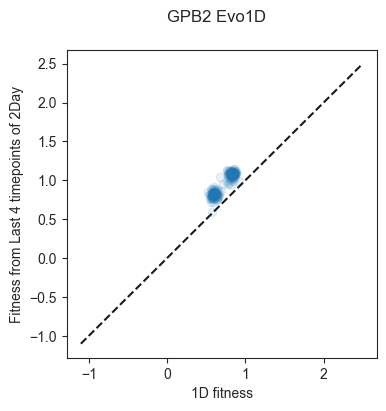

...

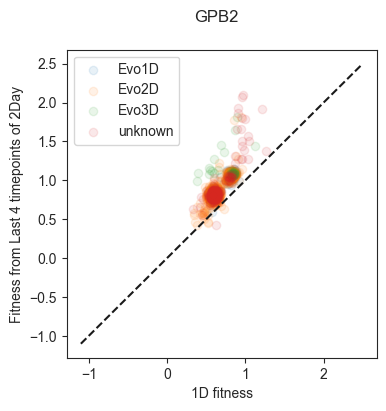

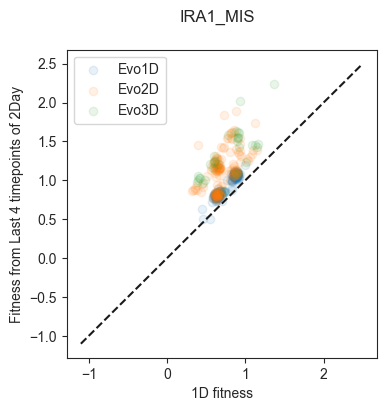

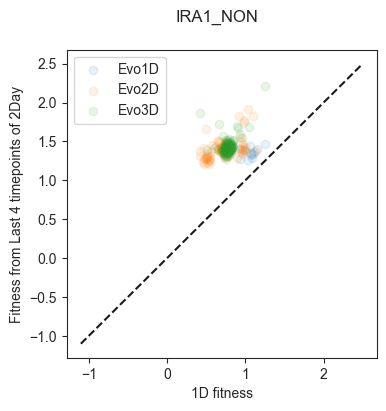

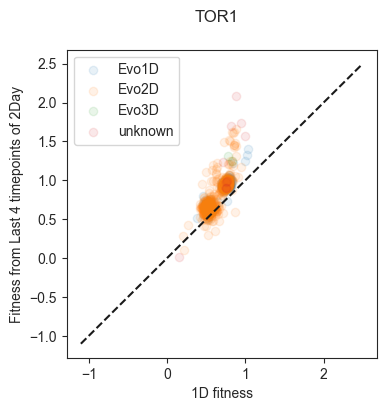

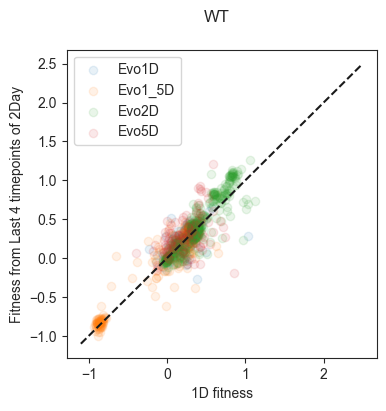

In [67]:
include_list = [4]

for anc in np.unique(merged_fitness['ancestor'].values):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
    
    for e,evo_cond in enumerate(np.unique(this_anc['evolution_condition'].values)):
        
        this_anc_indices = np.where((merged_fitness['ancestor']==anc)&(merged_fitness['evolution_condition']==evo_cond))[0]
        
        plt.figure(figsize=(len(include_list)*4,4))
        plt.suptitle(f'{anc} {evo_cond}')
        for n,n_to_include in enumerate(include_list):
            plt.subplot(1,len(include_list),n+1)
            plt.scatter(merged_fitness['Fit1D_both2%5%_fitness'].values[this_anc_indices],
                        np.nanmean(new_plotting[this_anc_indices,:-1*n_to_include],axis=1),
                        alpha=0.1)

            plt.plot([-1.1,2.5],[-1.1,2.5],color='k',linestyle='--')
            plt.xlabel('1D fitness')
            plt.ylabel(f'Fitness from Last {n_to_include} timepoints of 2Day')
#         plt.savefig(f'plots/last_4timepoints_vs_1Day_{anc}_{evo_cond}.pdf',bbox_inches='tight')
        
for anc in np.unique(merged_fitness['ancestor'].values):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
    plt.figure(figsize=(len(include_list)*4,4))
    plt.suptitle(f'{anc}')
    
        
        
    for n,n_to_include in enumerate(include_list):
        plt.subplot(1,len(include_list),n+1)
        for e,evo_cond in enumerate(np.unique(this_anc['evolution_condition'].values)):
            this_anc_indices = np.where((merged_fitness['ancestor']==anc)&(merged_fitness['evolution_condition']==evo_cond))[0]
                
            plt.scatter(merged_fitness['Fit1D_both2%5%_fitness'].values[this_anc_indices],
                        np.nanmean(new_plotting[this_anc_indices,:-1*n_to_include],axis=1),
                        alpha=0.1,label=evo_cond)

        plt.plot([-1.1,2.5],[-1.1,2.5],color='k',linestyle='--')
        plt.xlabel('1D fitness')
        plt.legend()
        plt.ylabel(f'Fitness from Last {n_to_include} timepoints of 2Day')
#     plt.savefig(f'plots/last_4timepoints_vs_1Day_{anc}.pdf',bbox_inches='tight')

In [45]:
np.tile(frac_list,len(this_anc_indices)).reshape(new_plotting[this_anc_indices,:].shape)

array([[0.01731139, 0.04330131, 0.10380878, ..., 0.81614758, 0.89568258,
        0.92276964],
       [0.01731139, 0.04330131, 0.10380878, ..., 0.81614758, 0.89568258,
        0.92276964],
       [0.01731139, 0.04330131, 0.10380878, ..., 0.81614758, 0.89568258,
        0.92276964],
       ...,
       [0.01731139, 0.04330131, 0.10380878, ..., 0.81614758, 0.89568258,
        0.92276964],
       [0.01731139, 0.04330131, 0.10380878, ..., 0.81614758, 0.89568258,
        0.92276964],
       [0.01731139, 0.04330131, 0.10380878, ..., 0.81614758, 0.89568258,
        0.92276964]])

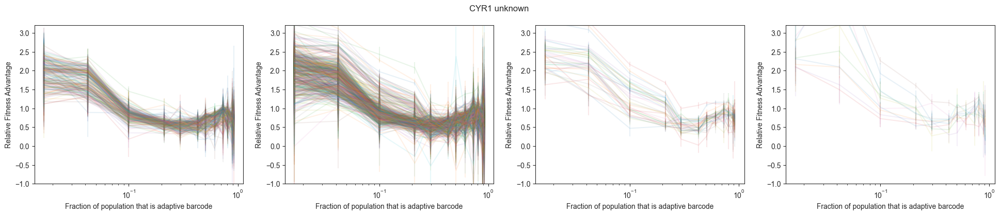

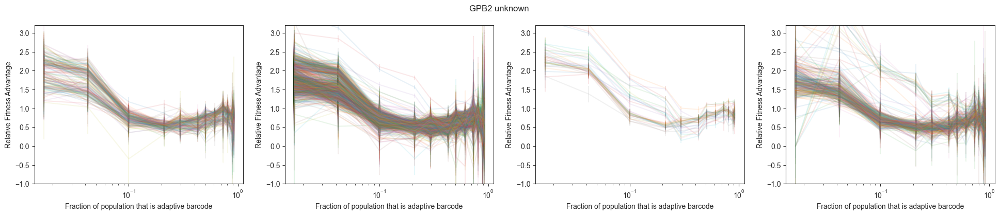

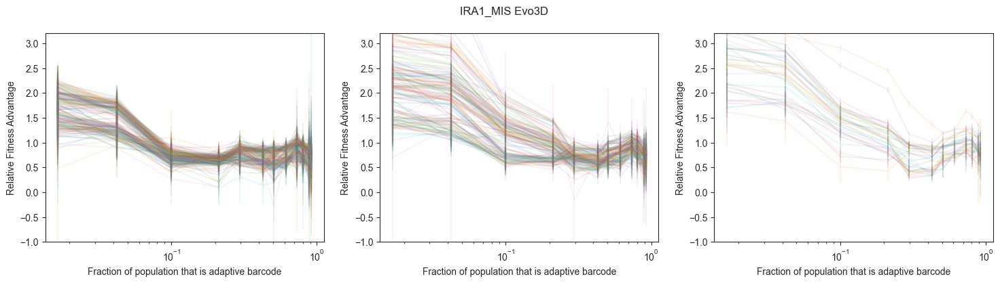

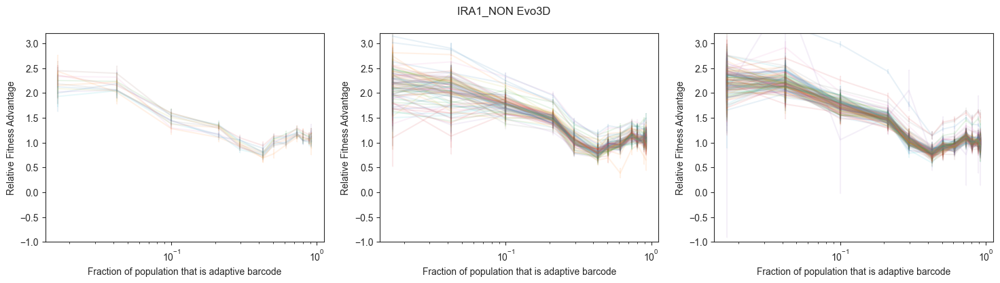

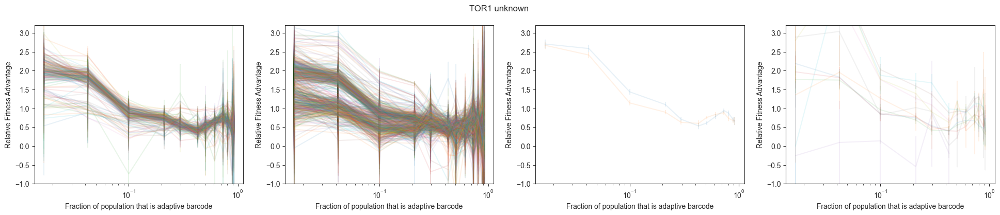

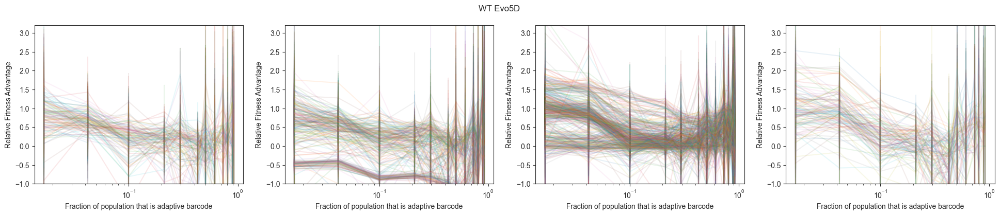

In [68]:
# include_list = [4]

for anc in np.unique(merged_fitness['ancestor'].values):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
    unique_evos = np.unique(this_anc['evolution_condition'].values)
    plt.figure(figsize=(6*len(unique_evos),4))
    for e,evo_cond in enumerate(unique_evos):
        plt.subplot(1,len(unique_evos),e+1)
        this_anc_indices = np.where((merged_fitness['ancestor']==anc)&(merged_fitness['evolution_condition']==evo_cond))[0]
        
        
        plt.suptitle(f'{anc} {evo_cond}')
            
        for anc_index in this_anc_indices:
            plt.errorbar(x=frac_list,
                    y=new_plotting[anc_index,:],yerr=new_plotting_error[anc_index,:],
                    alpha=0.1,capsize=0.1)

        plt.ylabel('Relative Fitness Advantage')
        plt.xlabel('Fraction of population that is adaptive barcode')
        plt.xscale('log')
        plt.ylim(-1,3.2)


#     plt.savefig(f'plots/{anc}_fitness_by_frequency_with_err.pdf',bbox_inches='tight')

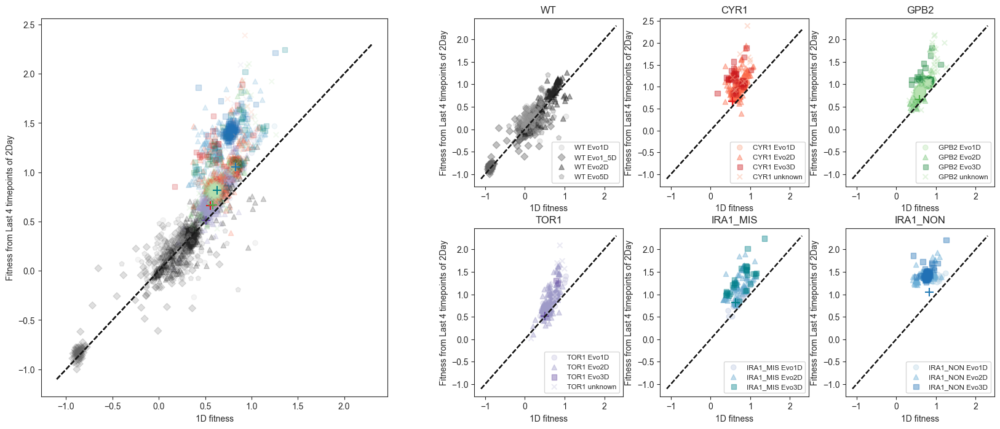

In [69]:
include_list = [4]

ancestor_list = [['WT','CYR1','GPB2','TOR1','IRA1_MIS','IRA1_NON'],['WT'],['CYR1'],['GPB2'],['TOR1'],['IRA1_MIS'],['IRA1_NON']]

for n,n_to_include in enumerate(include_list):
    fig = plt.figure(figsize=(20,8))
    outer_gs = gridspec.GridSpec(1, 2,width_ratios=[2,3])
    inner_gs = gridspec.GridSpecFromSubplotSpec(2,3,subplot_spec = outer_gs[1],hspace=0.25,wspace=0.25)
    for a,ancs in enumerate(ancestor_list):
        
        this_anc = merged_fitness[merged_fitness['ancestor'].isin(ancs)]

        if len(ancs) > 1:
            fig.add_subplot(outer_gs[0]) 
        else:
            fig.add_subplot(inner_gs[a-1])

        for e,evo_cond in enumerate(np.unique(this_anc['evolution_condition'].values)):
            
            this_anc_indices = np.where((merged_fitness['ancestor'].isin(ancs))&(merged_fitness['evolution_condition']==evo_cond))[0]
#             print(anc,evo_cond,this_anc_indices)
            plt.plot([-1.1,2.3],[-1.1,2.3],color='k',linestyle='--')
            plt.xlabel('1D fitness')
            plt.ylabel(f'Fitness from Last {n_to_include} timepoints of 2Day')
            
            colors = [tools.anc_evo_cond_color_map[anc][evo_cond] for anc,evo_cond in zip(merged_fitness['ancestor'],merged_fitness['evolution_condition'])]

            if len(ancs) > 1:
                alpha = 0.2
    #             fig.add_subplot(outer_gs[0])
                plt.scatter(merged_fitness['Fit1D_both2%5%_fitness'].values[this_anc_indices],
                        np.nanmean(new_plotting[this_anc_indices,:-1*n_to_include],axis=1),
                        alpha=alpha,color=np.asarray(colors)[this_anc_indices],
                            marker=tools.evo_cond_marker_map[evo_cond])
            else:
                alpha = 0.4
                plt.scatter(merged_fitness['Fit1D_both2%5%_fitness'].values[this_anc_indices],
                        np.nanmean(new_plotting[this_anc_indices,:-1*n_to_include],axis=1),
                        alpha=alpha,color=np.asarray(colors)[this_anc_indices],
                        label=f'{ancs[0]} {evo_cond}',marker=tools.evo_cond_marker_map[evo_cond])
                plt.legend(loc='lower right',fontsize='small')
                plt.title(f'{ancs[0]}')


        for anc in ancs:
            if anc != 'WT':
                background_mutant_index = np.where(merged_fitness['barcode']==rebarcoding_source_mutants[anc])[0]

                plt.scatter(merged_fitness['Fit1D_both2%5%_fitness'].values[background_mutant_index],
                            np.nanmean(new_plotting[background_mutant_index,:-1*n_to_include],axis=1),
                            marker='+',color=tools.anc_color_map[anc],s=100)



#     plt.savefig(f'plots/last_{n_to_include}timepoints_vs_1Day_ALL.pdf',bbox_inches='tight')
        

In [70]:
early_2day_intervals = ['Fit2D-2%_R1_T0','Fit2D-2%_R2_T0','Fit2D-5%_R1_T0','Fit2D-5%_R2_T0']
# early_2day_intervals = ['Fit2D-2%_R1_T0','Fit2D-2%_R2_T0']
early_2day_fitness,early_2day_error = tools.inverse_variance_mean(time_fitness[early_2day_intervals].values,
                                                 time_fitness[[x+'_error' for x in early_2day_intervals]].values)

merged_fitness['Fit2D_early_fitness'] = early_2day_fitness
merged_fitness['Fit2D_early_error'] = early_2day_error



# early_2day_intervals_li2019neutrals = [x+'_Li2019Neutrals' for x in early_2day_intervals]
# early_2day_fitness_li2019neutrals = tools.inverse_variance_mean(time_fitness[early_2day_intervals_li2019neutrals].values,
#                                                  time_fitness[[x+'_error' for x in early_2day_intervals_li2019neutrals]].values)



In [71]:

merged_fitness['ResPerHour'] = (early_2day_fitness-merged_fitness['Fit1D_both2%5%_fitness'].values)/24


# merged_fitness['ResPerHour'] = (merged_fitness['Fit2D_both2%5%_fitness'].values-merged_fitness['Fit1D_both2%5%_fitness'].values)/24
merged_fitness['FerPerHour'] = (merged_fitness['Fit1D_both2%5%_fitness'].values-4*merged_fitness['ResPerHour'])/16
merged_fitness['StaPerHour'] = (merged_fitness['Fit5D_both2%5%_fitness'].values-merged_fitness['Fit3D_both2%5%_fitness'].values)/48

merged_fitness['ResPerHour_Li2019Neutrals'] = (merged_fitness['Fit2D_both2%5%_fitness_Li2019Neutrals'].values-merged_fitness['Fit1D_both2%5%_fitness_Li2019Neutrals'].values)/24
merged_fitness['FerPerHour_Li2019Neutrals'] = (merged_fitness['Fit1D_both2%5%_fitness_Li2019Neutrals'].values-4*merged_fitness['ResPerHour_Li2019Neutrals'])/16
merged_fitness['StaPerHour_Li2019Neutrals'] = (merged_fitness['Fit5D_both2%5%_fitness_Li2019Neutrals'].values-merged_fitness['Fit3D_both2%5%_fitness_Li2019Neutrals'].values)/48


merged_fitness['ResPerHour_properNeutral'] = [merged_fitness['ResPerHour'].values[count] if pub != 'Li2019' else merged_fitness['ResPerHour_Li2019Neutrals'].values[count] for count,pub in enumerate(merged_fitness['source_publication'])]
merged_fitness['FerPerHour_properNeutral'] = [merged_fitness['FerPerHour'].values[count] if pub != 'Li2019' else merged_fitness['FerPerHour_Li2019Neutrals'].values[count] for count,pub in enumerate(merged_fitness['source_publication'])]
merged_fitness['StaPerHour_properNeutral'] = [merged_fitness['StaPerHour'].values[count] if pub != 'Li2019' else merged_fitness['StaPerHour_Li2019Neutrals'].values[count] for count,pub in enumerate(merged_fitness['source_publication'])]



In [72]:
wt_map = {'WT':'k',
             'GPB2':'#4daf4a',
             'CYR1':'#e41a1c',
             'TOR1':'#6a51a3',
             'IRA1_MIS':'#02818a',
             'IRA1_NON':'#1f78b4',
            }

marker_map = {'Evo1D':'o',
              'Evo2D':'^',
              'Evo3D':'s',
              'Evo5D':'p',
              'Evo1_5D':'D',
              'unknown':'x',
             }

color_map = {'WT':{'Evo1D':'#cccccc','Evo2D':'#252525','Evo5D':'#969696','Evo1_5D':'#636363'},
             'GPB2':{'Evo1D':'#bae4b3','Evo2D':'#74c476','Evo3D':'#238b45','unknown':'#bae4b3'},
             'CYR1':{'Evo1D':'#fcae91','Evo2D':'#fb6a4a','Evo3D':'#cb181d','unknown':'#fcae91'},
             'TOR1':{'Evo1D':'#cbc9e2','Evo2D':'#9e9ac8','Evo3D':'#6a51a3','unknown':'#cbc9e2'},
             'IRA1_MIS':{'Evo1D':'#bdc9e1','Evo2D':'#67a9cf','Evo3D':'#02818a','unknown':'#bdc9e1'},
             'IRA1_NON':{'Evo1D':'#bdd7e7','Evo2D':'#6baed6','Evo3D':'#2171b5','unknown':'#bdd7e7'}
            }

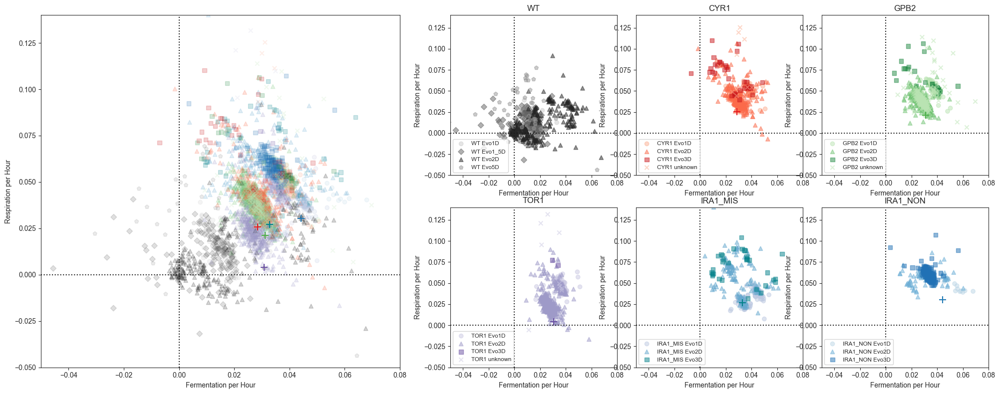

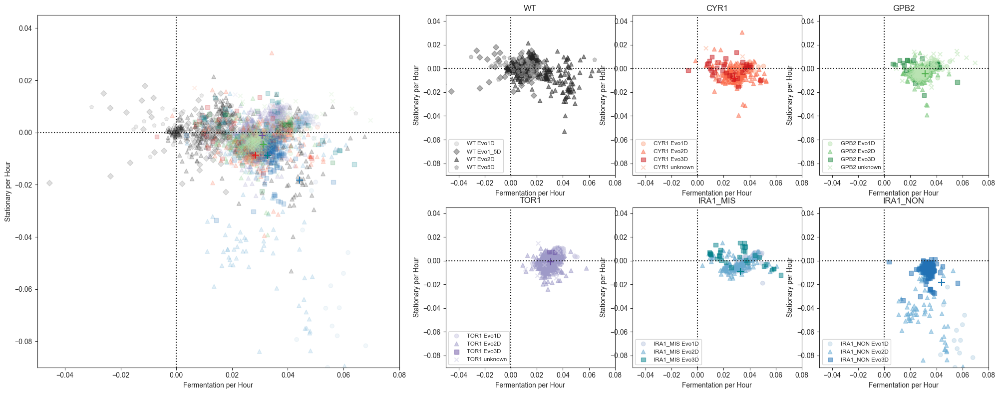

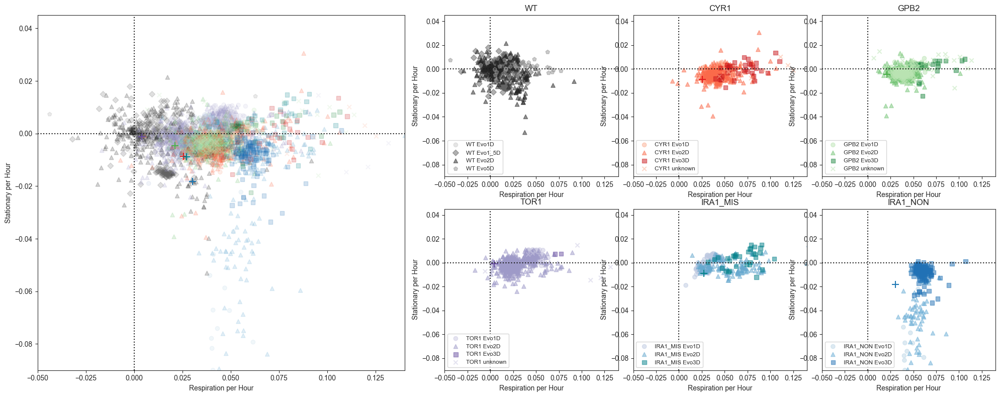

In [73]:


colors = [color_map[anc] for anc in merged_fitness['ancestor']]
# colors = ['b' if source=='This_study' else 'r' if source=='Li2019' else 'orange' if source == 'Aggeli2020' else 'k' for source in nonan_merged['source_publication_x']]

non_diploid = merged_fitness[merged_fitness['ploidy']!='Diploid']

xlabel = 'Fermentation per Hour'
ylabel = 'Respiration per Hour'
xdata = 'FerPerHour'
ydata = 'ResPerHour'

xlabel = 'Stationary per Hour'
ylabel = 'Respiration per Hour'
xdata = 'StaPerHour'
ydata = 'ResPerHour'
labels = {'FerPerHour':'Fermentation per Hour','ResPerHour':'Respiration per Hour','StaPerHour':'Stationary per Hour'}
lims = {'FerPerHour':[-0.05,0.08],'ResPerHour':[-0.05,0.14],'StaPerHour':[-0.09,0.045]}


for xdata,ydata in combinations(['FerPerHour','ResPerHour','StaPerHour'],2):
# publication_list = [['This_study','Li2019','Aggeli2020','Venkataram2015'],['Venkataram2015'],['Li2019'],['Aggeli2020'],['This_study'],['Venkataram2015','This_study']] 
    ancestor_list = [['WT','CYR1','GPB2','TOR1','IRA1_MIS','IRA1_NON'],['WT'],['CYR1'],['GPB2'],['TOR1'],['IRA1_MIS'],['IRA1_NON']]
    fig = plt.figure(figsize=(20,8))
    outer_gs = gridspec.GridSpec(1, 2,width_ratios=[2,3])

    for a,ancs in enumerate(ancestor_list):
        inner_gs = gridspec.GridSpecFromSubplotSpec(2,3,subplot_spec = outer_gs[1])
        this_anc = non_diploid[non_diploid['ancestor'].isin(ancs)]

        if len(ancs) > 1:
            fig.add_subplot(outer_gs[0]) 
        else:
            fig.add_subplot(inner_gs[a-1])


        for evo_cond in np.unique(this_anc['evolution_condition'].values):
            this_data = this_anc[this_anc['evolution_condition']==evo_cond]

            colors = [color_map[anc][evo_cond] for anc,evo_cond in zip(this_data['ancestor'],this_data['evolution_condition'])]

            if len(ancs) > 1:
                alpha = 0.2
    #             fig.add_subplot(outer_gs[0])
                plt.scatter(this_data[xdata].values,this_data[ydata].values,
                            alpha=alpha,color=colors,marker=marker_map[evo_cond])
            else:
                alpha = 0.5
                plt.scatter(this_data[xdata].values,this_data[ydata].values,
                            alpha=alpha,color=colors,marker=marker_map[evo_cond],label=f'{ancs[0]} {evo_cond}')
                plt.legend(loc='lower left',fontsize='small')
                plt.title(f'{ancs[0]}')


        for anc in ancs:
            if anc != 'WT':
                background_mutant = merged_fitness[merged_fitness['barcode']==rebarcoding_source_mutants[anc]]
                plt.scatter(background_mutant[xdata].values,background_mutant[ydata].values,marker='+',color=wt_map[anc],s=100)


        plt.xlim(lims[xdata][0],lims[xdata][1])
        plt.ylim(lims[ydata][0],lims[ydata][1])

        plt.xlabel(labels[xdata])
        plt.ylabel(labels[ydata])

        plt.axvline(0,color='k',linestyle=':')
        plt.axhline(0,color='k',linestyle=':')


    plt.tight_layout()
#     plt.savefig(f'tradeoffs_{xdata}_{ydata}.pdf',bbox_inches='tight')





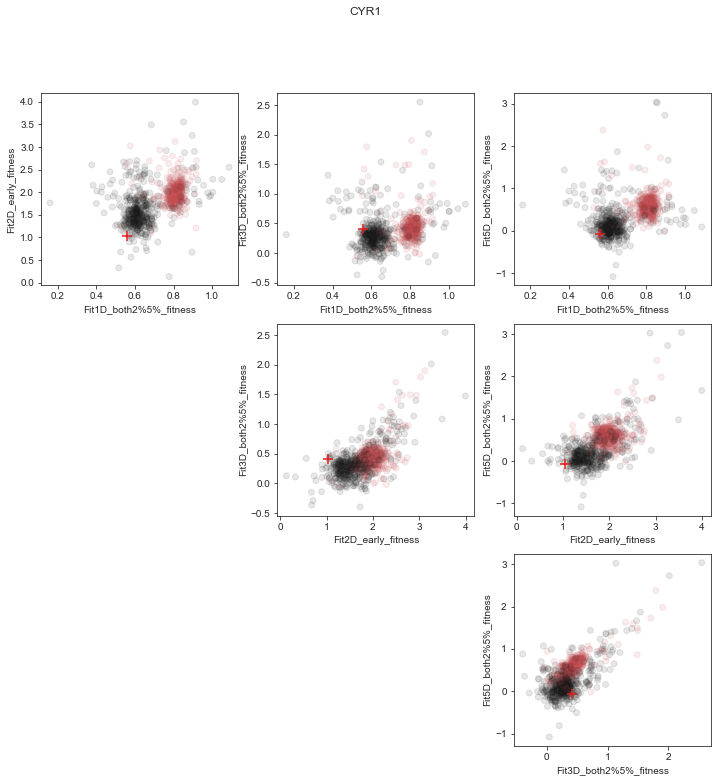

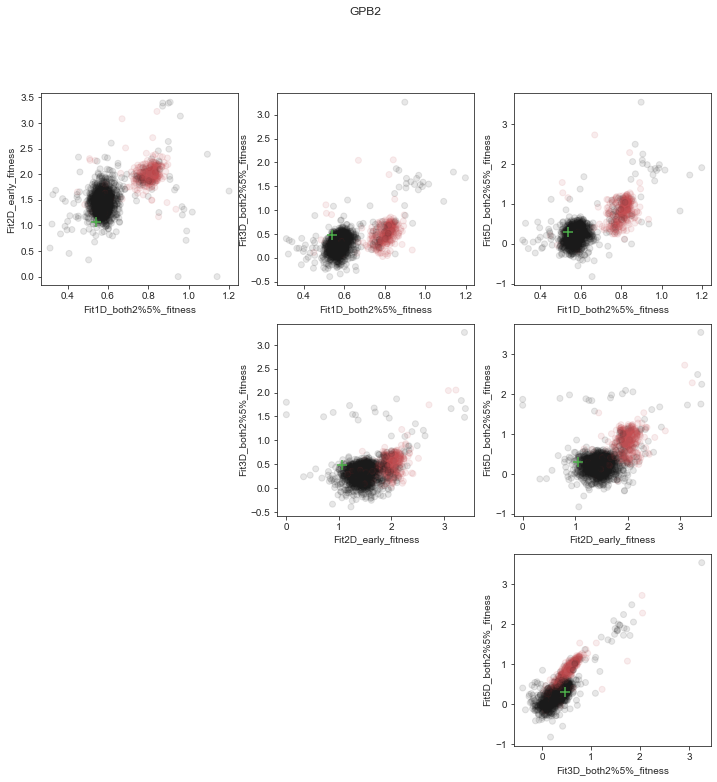

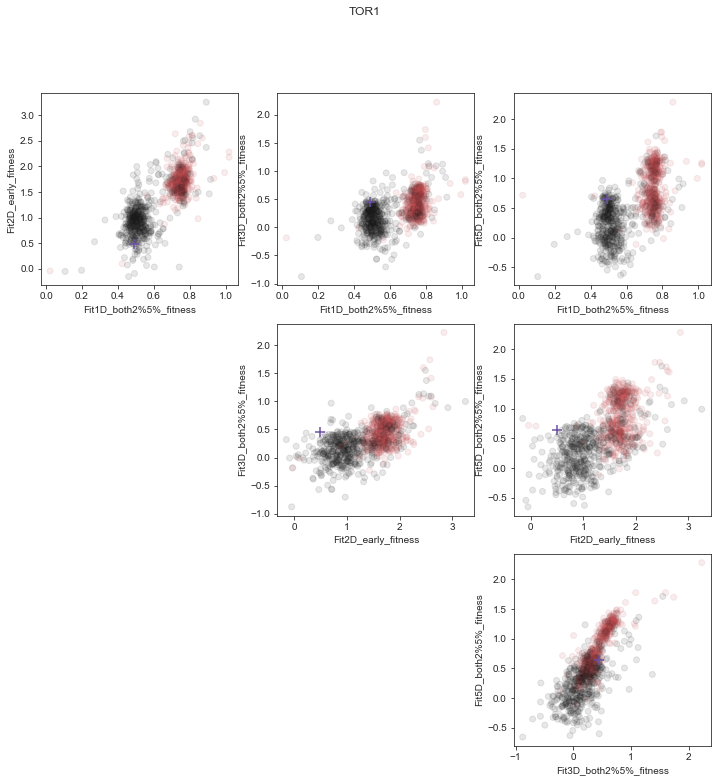

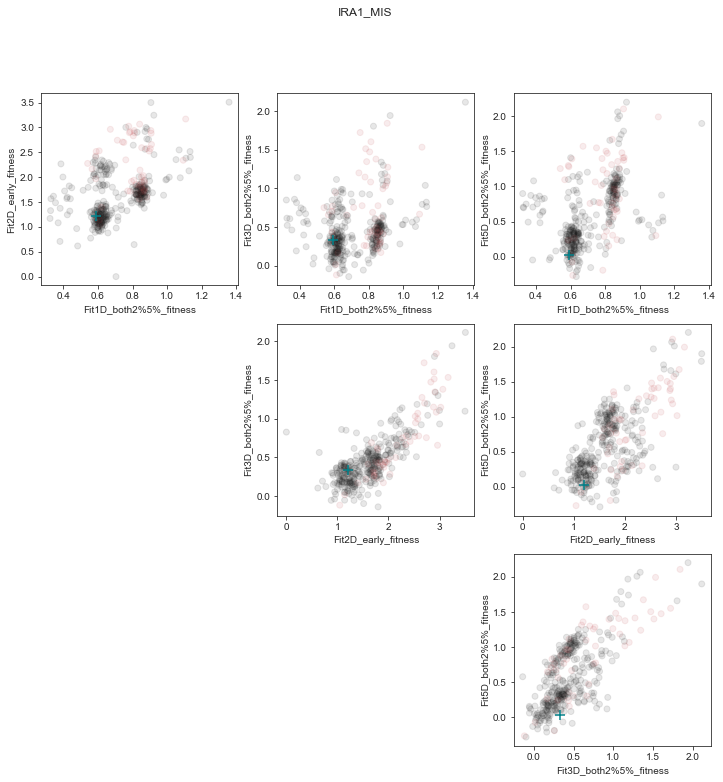

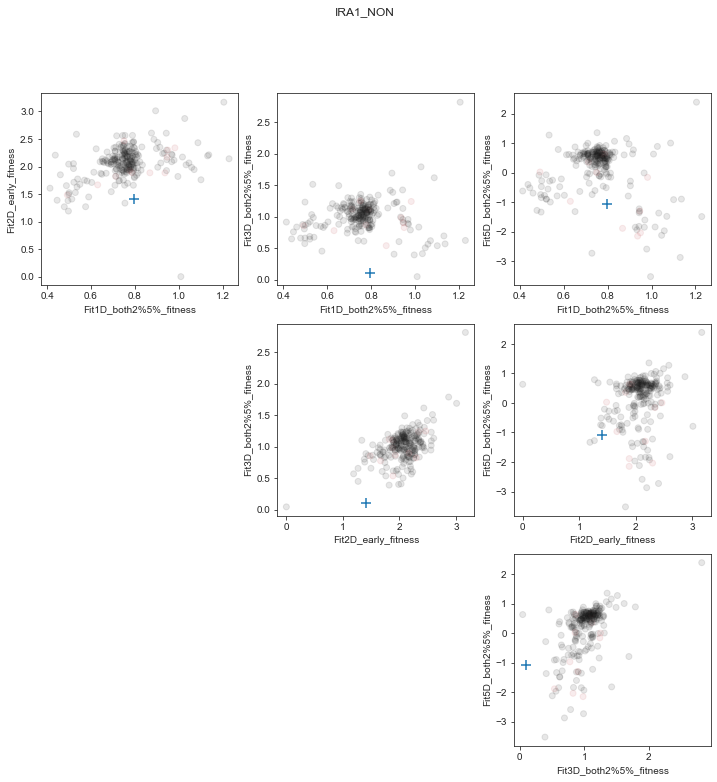

In [32]:
### PICKING WGS TARGETS

ancestor_list = ['CYR1','GPB2','TOR1','IRA1_MIS','IRA1_NON']

conditions = ['Fit1D_both2%5%_fitness','Fit2D_early_fitness','Fit3D_both2%5%_fitness','Fit5D_both2%5%_fitness']

for a,anc in enumerate(ancestor_list):
    this_anc = merged_fitness[merged_fitness['ancestor']==anc]
#     for evo_cond in np.unique(this_anc['evolution_condition'].values):
    
    plt.figure(figsize=(4*3,4*3))
    plt.suptitle(anc)
    
    background_mutant = merged_fitness[merged_fitness['barcode']==rebarcoding_source_mutants[anc]]
    
    for x,y in combinations(range(len(conditions)),2):
        xdata = conditions[x]
        ydata = conditions[y]
        plt.subplot(3,3,3*x+y)
    
    
        colors =  ['k' if ploidy not in ['diploid','Diploid'] else 'r' for ploidy in this_anc['ploidy_new'].values]
        plt.scatter(this_anc[xdata],this_anc[ydata],color=colors,alpha=0.1)
        plt.scatter(background_mutant[xdata].values,background_mutant[ydata].values,marker='+',color=wt_map[anc],s=100)

        plt.xlabel(xdata)
        plt.ylabel(ydata)


In [20]:
pure

SyntaxError: invalid syntax (961556165.py, line 1)